<h1 align="center"><strong><font size="6"> The Soccer-Factor-Model <br> Identifying a Soccer-Player's Skill/Ability via Bayesian Logistic Regression </h1></strong></font>

(Actually, it's football, the *jogo bonito* that you play with your feet. But oddly, Americans call it *soccer*.)

Welcome to the notebook hosting the **Soccer-Factor-Model** (SFM). Before jumping into a short introduction into what the SFM actually is, I would like to make a few remarks upfront:

1. The SFM is not confined to soccer only, but can easliy be adpated to all kinds of other sports: football, baseball, basketball, Formula 1, etc. The only requirement: **data on individual players and/or teams**.

2. The model itself is implemented with the enormous help of **[#PyMC](https://www.pymc.io/welcome.html)**.

3. Given that **[#PyMC](https://www.pymc.io/welcome.html)** thankfully does all the heavy work, the actual **star** of the analysis is not the model construction and estimation, but rather the data/feature engineering part.

## Pre-Game Ramblings

### What's the Soccer-Factor-Model all about?

#### The Inspiration

The Soccer-Factor-Model (SFM) is inspired by the academic literature on asset-pricing along the following lines:

> 1. Factor Models à la [Fama & French](https://onlinelibrary.wiley.com/doi/full/10.1111/j.1540-6261.1992.tb04398.x) use "factors" to explain the cross-section of stock returns. <br>
 --> **here**: we use "Team-Factors" to explain away the role of the team's strength in making a given player $i$ score a goal.

> 2. There is some literature on the skill of investment fund managers that works in a similar way: "explain away" that proportion of a fund's returns that is related to economic fundamentals (e.g. [Coggin, Fabozzi, Rahman (1993)](https://onlinelibrary.wiley.com/doi/10.1111/j.1540-6261.1993.tb04029.x); [Fama & French (2010)](https://onlinelibrary.wiley.com/doi/10.1111/j.1540-6261.2010.01598.x); [Berg & van Binsbergen (2015)](https://www.sciencedirect.com/science/article/pii/S0304405X15000628)):
\begin{align}
  r_{p,t} = \alpha_p + \sum^N_{n=1} \beta_n \, f_{n,t} + \varepsilon_{p,t}
\end{align} <br>
 where $r_{p,t}$ is portfolio $p$'s return in excess of the risk-free rate (e.g. short-term U.S. government bonds). $f_{n,t}$ measures the return that one could generate by following the strategy prescribed by **factor $n$**, and $\varepsilon_{p,t}$ is a random error that is usually assumed to be mean zero. <br> The parameter of interest here is $\mathbf{\alpha_p}$. It is that part of a portfolio's conditional mean, that is not to be explained by the factors $f_{1,t},...,f_{N,t}$, and is a measure of the portfolio manager's **skill/ability**. Said differently: it quantifies the manager's ability to generate returns **beyond** the return you would have received by just following the investment strategy dictated by the factors.

#### From Asset-Pricing to Soccer

In our case, the "dependent variable"/"label"/"outcome variable" ($y_{i,s,m}$) will be a binary indicator, telling us whether player $i$ has scored a goal (or not) in season $s$ in match $m$:

\begin{align}
        y_{i,s,m} = \left\{
        \begin{array}{cl}
        0 & \textbf{not} \text{ scored} \\
        1 & \text{scored}
        \end{array}
        \right.
\end{align}

> *Sidenote*: This binary classification exercise is just a way to keep things simple. One may also want to predict the *number* of goals in a given match, which would make it for a multiclass extension.

The SFM is then set-up as follows:

\begin{align}
     p_{i,s,m} \equiv   P\left(y_{i,s,m} = 1 | \mathbf{x}_{i,s,m-1}, \alpha_i, \beta \right) = \sigma \left(\alpha_{i} + \mathbf{x}_{i,s,m-1} \, \mathbf{\beta} \right) \qquad \left( M.1 \right)
\end{align}

where:

> - $p_{i,s,m}$: &ensp;&ensp;&emsp; The probability of player $i$ scoring a goal in season $s$ in match $m$ *conditional* on $\mathbf{x}_{i,s,m-1}$, $\alpha_i$, and $\beta \;$ ;

> - $\mathbf{x}_{i,s,m-1}$: &emsp; A $\; 1 \times N$ vector of *factors* that are intended to resemble the imbalance between player $i$'s team and the <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; opponent-team. The subscript $m-1$ signals that these *factors* only contain information about the teams' <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; differences that prevail **before** the referee blows the whistle to start off match $m$ ! <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; Again, to be clear, these *factors* are intended to explain that fraction of $p_{i,s,m}$ that is due to the difference in the <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; strength  of player $i$'s team and the opponent-team;

> - $\beta$: &ensp;&ensp;&ensp;&ensp;&ensp;&emsp; The sensitivity of $p_{i,s,m}$ to the factors $\mathbf{x}_{i,s,m} \;$;

> - $\alpha_i$: &ensp;&ensp;&ensp;&ensp;&ensp; Our main parameter of interest as it captures that fraction of $p_{i,s,m}$ that is attributed to player $i$'s skill/ability only! <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; (Yes, later on, this parameter will carry a subscript $s$, $\alpha_{i,s} \;$, allowing a player's skill/ability to vary across seasons);

> - $\sigma \left(\cdot\right)$: &ensp;&ensp;&emsp; The $\mathtt{sigmoid}$ function, which transforms the predictions of the linear model $\alpha_i + \mathbf{X}_i \, \mathbf{\beta}$ into a number that <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; ranges between zero and one, such that $p_{i,s,m} \in \left[0;1\right]$.

Just for notational convenience, we will re-write Equation ($M.1$) to get rid off the subscripts $s$ and $m$:

\begin{align}
     p_{i} \equiv   P\left(Y_{i} = 1 | \mathbf{X}_{i}, \alpha_i, \beta \right) = \sigma \left(\alpha_{i} + \mathbf{X}_{i} \, \mathbf{\beta} \right) \qquad \left( 1 \right )
\end{align}

where now:

> - $Y_{i}$: &ensp;&ensp;&ensp;&ensp;&ensp; A $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times 1$ vector of zeros and ones,
> - $\mathbf{X}_i$: &ensp;&ensp;&ensp;&ensp;&emsp; A $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times N$ matrix of *factors*
> > where
> > - $S_i$:  &ensp;&ensp;&ensp; The total number of seasons player $i$ has played,
> > - $M_{i,s}$: &ensp; The total number of matches played by player $i$ in season $s$.
> - $p_{i}$: &ensp;&ensp;&ensp;&ensp;&ensp; With a slight abuse of notation, a $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times 1$ vector of probabilities, with $p_{i} \in \left[0;1\right]$.

<br>

<font color='darkred'>**IMPORTANT**</font>: &emsp; The explanatory variables (*factors*, $\mathbf{X}_i$) describe the *state* that had persisted **before** a given match $m$ was played.  <br>
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; E.g., when we observe $y_{i,s,m}$, the *factors* will only capture information that was available to us **prior to** match $m$! <br>
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; Therefore, we will have the following mapping: $y_{i,s,m} \rightarrow \mathbf{x}_{i,s,m-1}$.

### Factors: The Heart of the SFM

Factors are intended to help us understand which part of $p_i$ is due to the strength of the **team** ( $\mathbf{X}_i \, \mathbf{\beta}$ ) that player $i$ is playing for, and which proportion of $p_i$ is due to player $i$'s **own** ($\alpha_i$) skill/ability. In that sense, $\alpha_i$ is our main parameter of interest as it gives us a measure of the **skill/ability** of player $i$ to score a goal.

<font color='darkred'>**NOTE**</font>: &emsp; Hard-core finance academics might be outraged with me making a comparison between the SFM-factors ($\mathbf{x}_{i,s,m-1}$) that I introduce below, and the **true** asset-pricing factors ($f_t$) mentioned above.
One reason is that the SFM-factors carry an additional subscript $i$, which indicates that these factors vary across teams or even across players. In contrast, the traditional asset-pricing factors are only varying across time, but are *invariant* across entities.

### Factor Engineering

The number of *factors* we can build and their informative value, depends obviously on the data that is available to us. For the following exercise, I depend on publicly available data free of charge. That is already a limitation for producing a meaningful model.

However, I guess I found a decent dataset, which I pulled from [#Kaggle](https://www.kaggle.com/datasets/marclamyhshshs/premier-league-games?select=clean_players_info.csv).
All credits for that dataset go to [Marc Lamyhshshs](https://www.kaggle.com/marclamyhshshs).
It comprises all Premier League matches since 1992, which allows us to look at some very, very, very interesting players!

The amount of data is surely impressive! This allows us to create some interesting *factors*.

To showcase how SFM works, I chose to construct the following ones:

- `goalsscored_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The current difference of *goals scored* by player $i$'s team and the opponent-team
- `goalsscored_rank_team`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The current ranking of player $i$'s team in *goals scored*
- `goalsscored_rank_team_wo_player`: &emsp; The current ranking of player $i$'s team in *goals scored*, not accounting for <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; the number of goals scored by player $i$
- `goalsconceded_rank_opp`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp; The current ranking of the opponent-team in *goals conceded*
- `points_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; The difference in points of the player's team and the opponent
- `goal_balance_team`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between *goals scored* and *goals conceded* of the team which <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; our player of interest is playing for
- `goal_balance_opp`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between *goals scored* and *goals conceded* of the opponent-team which <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; our player of interest is playing against in match $m$
- `goal_balance_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between `goal_balance_team` and `goal_balance_opp`

Throughout the notebook, I attached some questions about whether a given factor is actually related to team-effort or actually an indication of a player's strength. If the latter were true, we should exclude that particular factor as our model would be mis-specified! Or we would just hope that the posterior of the corresponding loading is centered around zero with only little variance...

<font color='darkred'>**Lastly:**</font> This list of factors is by no means comprehensive and much more creative minds might already have thought of many more fancy factors to build from the underlying data.
Feel free to build your own factors! Data on `shots_home` and `shots_away` sound to have potential to form other interesting explanatory variables that I haven't included yet!

## Data preparation

In [1]:
from typing import List, Union

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc as pm
import pytensor.tensor as pt
import seaborn as sns
import xarray as xr
from matplotlib.lines import Line2D

pm.__version__

'5.16.2'

In [2]:
az.style.use("arviz-whitegrid")
plt.rcParams["figure.figsize"] = [12, 5]
%config InlineBackend.figure_format = 'retina'
seed = sum(map(ord, "sfm"))
rng = np.random.default_rng(seed)

In [91]:
RLPs = pd.Index(
    [
        "harry kewell",
        "jermain defoe",
        "nicolas anelka",
        "robbie fowler",
        "robbie keane",
        "robert pires",
    ],
).sort_values()

factors_numeric = [
    #"goalsscored_rank_team",
    #"goalsscored_rank_team_wo_player",
    #"goalsconceded_rank_opp",
    "points_diff",
    #"goal_balance_diff",
]

factors = ["home_pitch"] + factors_numeric

In [ ]:
# pd.read_csv("../../10_data/101_SFM/SFM_multiple_leagues.csv")

In [92]:
complete_data = pd.read_csv("../../10_data/101_SFM/SFM_data.csv")

complete_data["goal"] = complete_data["goal"].astype(int)
complete_data["kickoff_dt"] = pd.to_datetime(
    complete_data["kickoff_dt"], yearfirst=True
).dt.normalize()

# compute season number for each player, ~maturity of player
complete_data["season_nbr"] = complete_data.groupby(["name_player"])[
    "season"
].transform(lambda x: x.factorize(sort=True)[0])

# compute days since first game of the season for each player
# aka within-season effects
complete_data["days_since_first_game"] = complete_data.groupby(
    ["name_player", "season"]
)["kickoff_dt"].transform(lambda x: (x - x.min()).dt.days)

complete_data["goals_in_match"] = complete_data["goals_in_match"].astype(int)
complete_data = complete_data.sort_values(["name_player", "kickoff_dt"]).reset_index(
    drop=True
)
complete_data["is_rlp"] = complete_data.name_player.isin(RLPs).astype(int)
players = pd.factorize(complete_data["name_player"], sort=True)[1]
players_ordered = players.difference(RLPs).append(RLPs)

complete_data

,goal,goals_in_match,points_team,points_opp,goalsscored_cum_team,goalsscored_cum_opp,goalsconceded_cum_team,goalsconceded_cum_opp,home_pitch,goalsscored_rank_team,...,goalsscored_diff,goal_balance_team,goal_balance_opp,goal_balance_diff,points_diff,goalsscored_share_player_team,name_player,season_nbr,days_since_first_game,is_rlp
0,1,2,11.0,3.0,7.0,5.0,3.0,12.0,1.0,13.0,...,2.0,4.0,-7.0,11.0,8.0,0.571429,alan shearer,0,0,0
1,0,0,14.0,10.0,11.0,10.0,4.0,9.0,0.0,5.0,...,1.0,7.0,1.0,6.0,4.0,0.545455,alan shearer,0,7,0
2,1,2,17.0,9.0,12.0,7.0,4.0,6.0,1.0,5.0,...,5.0,8.0,1.0,7.0,8.0,0.500000,alan shearer,0,10,0
3,1,1,17.0,5.0,14.0,8.0,7.0,12.0,0.0,2.0,...,6.0,7.0,-4.0,11.0,12.0,0.571429,alan shearer,0,14,0
4,1,1,18.0,11.0,15.0,18.0,8.0,17.0,1.0,4.0,...,-3.0,7.0,1.0,6.0,7.0,0.600000,alan shearer,0,21,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4458,0,0,35.0,43.0,35.0,46.0,9.0,10.0,1.0,1.0,...,-11.0,26.0,36.0,-10.0,-8.0,0.000000,zlatan ibrahimovic,1,22,0
4459,0,0,35.0,16.0,36.0,15.0,11.0,19.0,1.0,1.0,...,21.0,25.0,-4.0,29.0,19.0,0.000000,zlatan ibrahimovic,1,25,0
4460,0,0,38.0,14.0,37.0,12.0,11.0,22.0,0.0,1.0,...,25.0,26.0,-10.0,36.0,24.0,0.000000,zlatan ibrahimovic,1,29,0
4461,0,0,41.0,26.0,39.0,27.0,12.0,26.0,0.0,2.0,...,12.0,27.0,1.0,26.0,15.0,0.000000,zlatan ibrahimovic,1,35,0


### Factor standardization

In [158]:
from sklearn.preprocessing import StandardScaler

In [159]:
factors_numeric_train = complete_data[factors_numeric]

scaler = StandardScaler()
# Fit the scaler on the training data and transform the data
factors_numeric_sdz = pd.DataFrame(scaler.fit_transform(factors_numeric_train), columns=factors_numeric)

# Add the non-numeric factor to the standardized DataFrame
factors_sdz = factors_numeric_sdz.copy()
factors_sdz["home_pitch"] = complete_data["home_pitch"]

# make sure the order is the same as the PyMC coords later on
factors_sdz = factors_sdz[factors]

In [160]:
factors_sdz

,home_pitch,points_diff
0,1.0,-0.029064
1,0.0,-0.302426
2,1.0,-0.029064
3,0.0,0.244299
4,1.0,-0.097404
...,...,...
4458,1.0,-1.122513
4459,1.0,0.722683
4460,0.0,1.064386
4461,0.0,0.449321


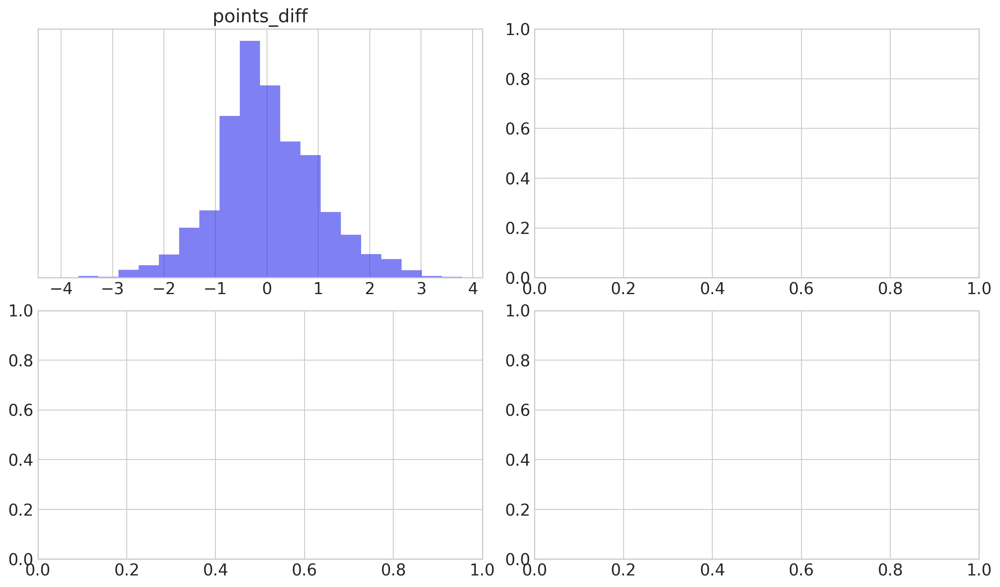

In [94]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7), layout="constrained")
axes = axes.flatten()

for (i, factor) in enumerate(factors_numeric):
    axes[i].hist(factors_numeric_sdz[factor], alpha=0.6, bins=20)
    axes[i].set(title=factor, yticks=[])

## Why an Ordered Categorical likelihood

Let's give a good look at the frequency of each count in the data. First in terms of probability:

In [95]:
complete_data["goals_in_match"].value_counts(normalize=True).round(4)

goals_in_match
0    0.6778
1    0.2454
2    0.0618
3    0.0125
4    0.0018
5    0.0007
Name: proportion, dtype: float64

Then raw counts:

In [96]:
complete_data["goals_in_match"].value_counts()

goals_in_match
0    3025
1    1095
2     276
3      56
4       8
5       3
Name: count, dtype: int64

**The counts for 3+ goals are extremely rare compared to 0, 1 and 2 goals**. This means using a Poisson likelihood is not really appropriate, as the Poisson expects much higher counts on the right tail of the distribution.

In this case, it makes more sense to use a **Categorical likelihood with categories $[0, 1, 2, 3+]$**. That may sound counter-intuitive, as in theory the number of goals a player can score per game has no upper bound (hence the Poisson), but in practice, we see this number exceeds 2 less than 2% of the time.

As a result, lumping together any observations equal or higher to 3, and treating each of the 4 events as a distinct category, with its own probability of success, makes more sense and allows for a more sensical model.

In [97]:
# lump together values >= 3
complete_data["goals_cats"] = np.where(
    complete_data["goals_in_match"] >= 3, 3, complete_data["goals_in_match"]
)

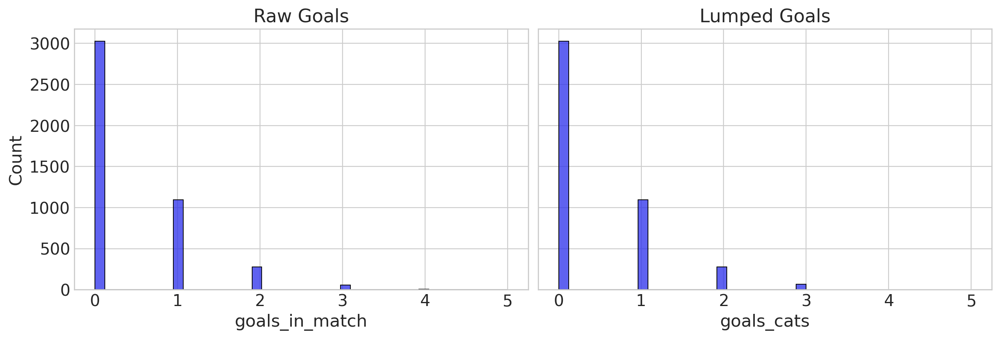

In [98]:
_, (left, right) = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(12, 4))
sns.histplot(complete_data, x="goals_in_match", ax=left)
left.set(title="Raw Goals")
sns.histplot(complete_data, x="goals_cats", ax=right)
right.set(title="Lumped Goals");

We can see that this virtually doesn't change anything, because the frequencies are so low for high counts. We can now implement the model.

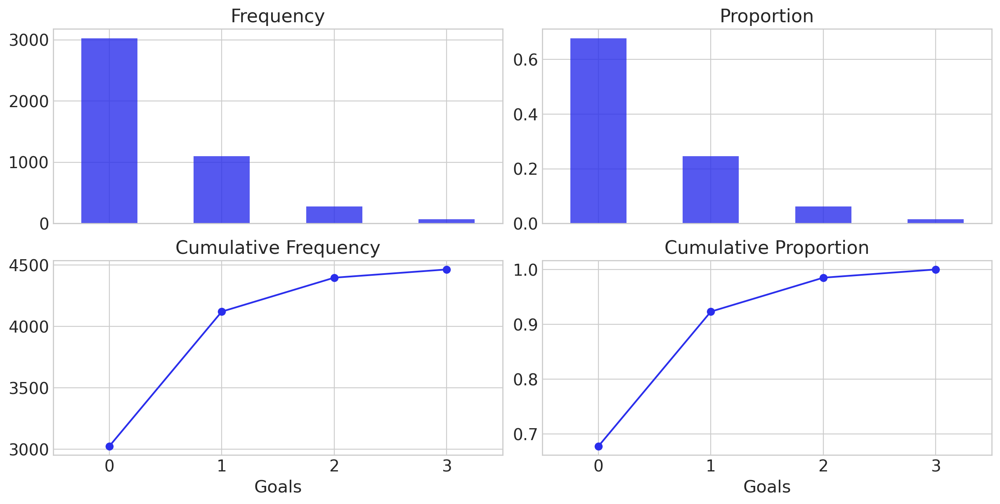

In [99]:
_, axes = plt.subplot_mosaic(
    [
        ["Frequency", "Proportion"],
        ["Cumulative Frequency", "Cumulative Proportion"],
    ],
    figsize=(12, 6),
    sharex=True,
    layout="constrained",
)

complete_data["goals_cats"].sort_values().value_counts(sort=False).plot(
    kind="bar", alpha=0.8, rot=0, ax=axes["Frequency"]
)
axes["Frequency"].set(xlabel="Goals", title="Frequency")

complete_data["goals_cats"].sort_values().value_counts(sort=False, normalize=True).plot(
    kind="bar", alpha=0.8, rot=0, ax=axes["Proportion"]
)
axes["Proportion"].set(xlabel="Goals", title="Proportion")

complete_data["goals_cats"].sort_values().value_counts(sort=False).cumsum().plot(
    marker="o", rot=0, ax=axes["Cumulative Frequency"]
)
axes["Cumulative Frequency"].set(xlabel="Goals", title="Cumulative Frequency")

complete_data["goals_cats"].sort_values().value_counts(
    sort=False, normalize=True
).cumsum().plot(marker="o", rot=0, ax=axes["Cumulative Proportion"])
axes["Cumulative Proportion"].set(xlabel="Goals", title="Cumulative Proportion");

In [100]:
complete_data["goals_cats"].sort_values().value_counts(sort=False).cumsum()

goals_cats
0    3025
1    4120
2    4396
3    4463
Name: count, dtype: int64

In [101]:
complete_data["goals_cats"].sort_values().value_counts(sort=False, normalize=True)

goals_cats
0    0.677795
1    0.245351
2    0.061842
3    0.015012
Name: proportion, dtype: float64

## Within-season & Across seasons fluctuations

> Are there non-linear effects?

### In total

In [13]:
complete_data["week_since_first_game"] = complete_data["days_since_first_game"] // 7

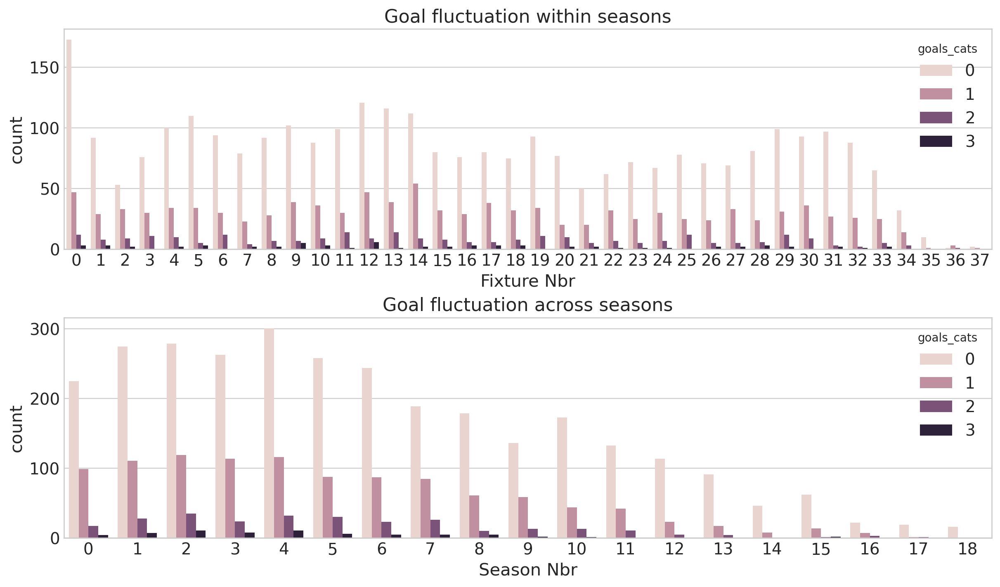

In [14]:
_, (up, down) = plt.subplots(
    2,
    1,
    figsize=(12, 7),
    layout="constrained",
)
grouped_data = (
    complete_data.groupby(["week_since_first_game", "goals_cats"])
    .size()
    .reset_index(name="count")
)
sns.barplot(
    data=grouped_data, x="week_since_first_game", y="count", hue="goals_cats", ax=up
)
up.set(title="Goal fluctuation within seasons", xlabel="Fixture Nbr")

grouped_data = (
    complete_data.groupby(["season_nbr", "goals_cats"]).size().reset_index(name="count")
)
sns.barplot(data=grouped_data, x="season_nbr", y="count", hue="goals_cats", ax=down)
down.set(title="Goal fluctuation across seasons", xlabel="Season Nbr");

### Per player

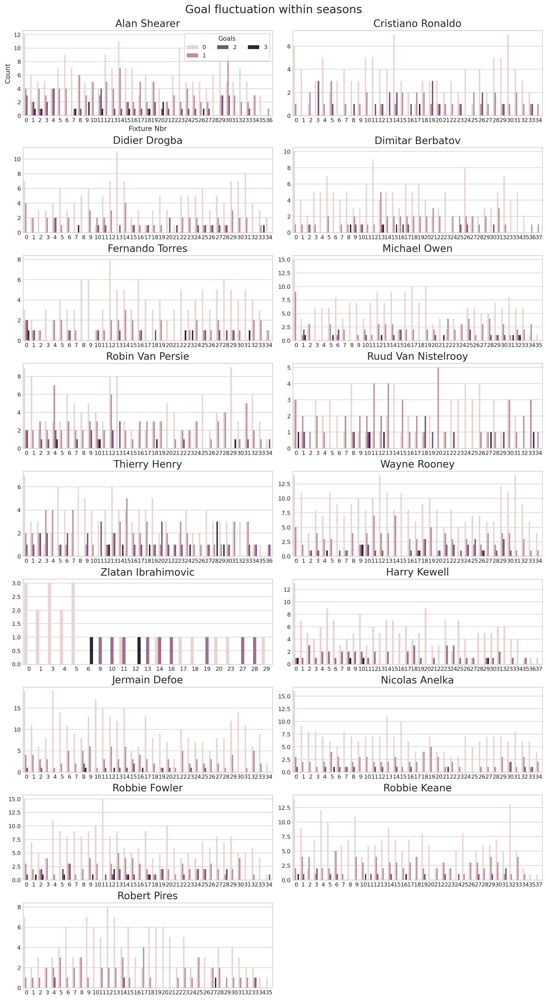

In [15]:
_, axes = plt.subplots(9, 2, figsize=(12, 22), layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    grouped_data = (
        complete_data[complete_data.name_player == player]
        .groupby(["week_since_first_game", "goals_cats"])
        .size()
        .reset_index(name="count")
    )
    sns.barplot(
        data=grouped_data, x="week_since_first_game", y="count", hue="goals_cats", ax=ax
    )
    ax.set(title=f"{player.title()}")
    ax.tick_params(axis="both", which="major", labelsize=9)
    if i > 0:
        ax.get_legend().remove()
        ax.set_xlabel("")
        ax.set_ylabel("")
    else:
        ax.set_xlabel("Fixture Nbr", fontsize=11)
        ax.set_ylabel("Count", fontsize=11)
        ax.legend(frameon=True, ncols=3, fontsize=9, title="Goals", title_fontsize=10)

plt.suptitle("Goal fluctuation within seasons", fontsize=18);

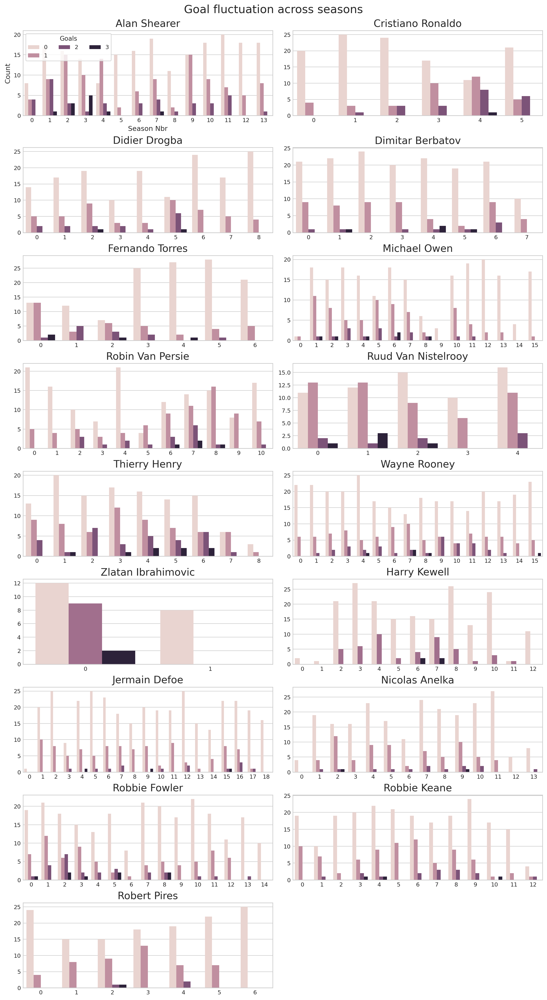

In [16]:
_, axes = plt.subplots(9, 2, figsize=(12, 22), layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    grouped_data = (
        complete_data[complete_data.name_player == player]
        .groupby(["season_nbr", "goals_cats"])
        .size()
        .reset_index(name="count")
    )
    sns.barplot(data=grouped_data, x="season_nbr", y="count", hue="goals_cats", ax=ax)
    ax.set(title=f"{player.title()}")
    ax.tick_params(axis="both", which="major", labelsize=9)
    if i > 0:
        ax.get_legend().remove()
        ax.set_xlabel("")
        ax.set_ylabel("")
    else:
        ax.set_xlabel("Season Nbr", fontsize=11)
        ax.set_ylabel("Count", fontsize=11)
        ax.legend(frameon=True, ncols=3, fontsize=9, title="Goals", title_fontsize=10)

plt.suptitle("Goal fluctuation across seasons", fontsize=18);

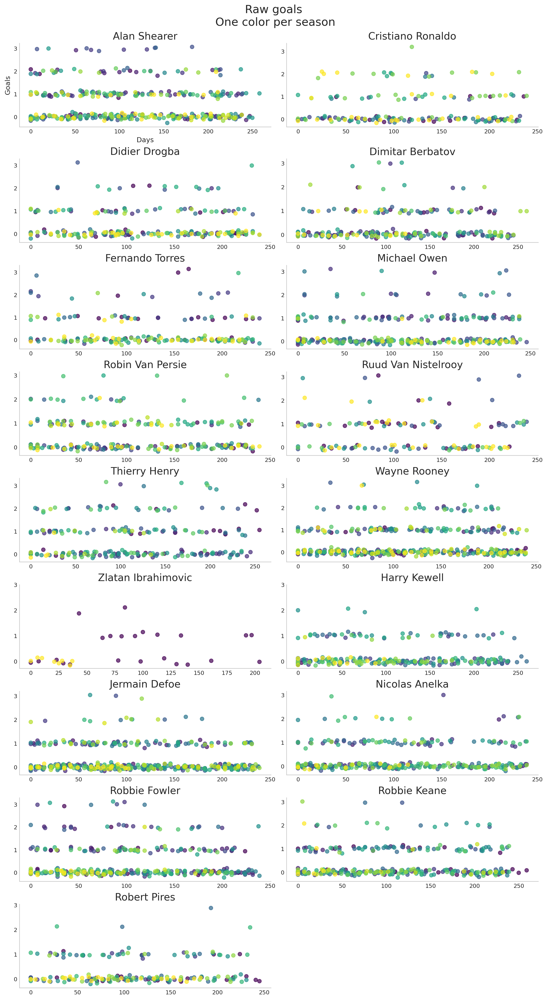

In [17]:
_, axes = plt.subplots(9, 2, figsize=(12, 22), layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):

    grouped_data = complete_data.loc[
        complete_data.name_player == player,
        ["days_since_first_game", "season_nbr", "goals_cats"],
    ].sort_values(["season_nbr", "days_since_first_game"])
    grouped_data["goals_cats"] = grouped_data["goals_cats"] + rng.normal(
        0, 0.07, len(grouped_data)
    )

    colors = plt.cm.viridis(
        grouped_data["season_nbr"] / grouped_data["season_nbr"].max()
    )
    ax.scatter(
        grouped_data["days_since_first_game"],
        grouped_data["goals_cats"],
        c=colors,
        alpha=0.7,
    )

    ax.set(title=f"{player.title()}", yticks=np.arange(4, dtype=int))
    ax.tick_params(axis="both", which="major", labelsize=9)

    if i > 0:
        ax.set(xlabel="", ylabel="")
    else:
        ax.set_xlabel("Days", fontsize=11)
        ax.set_ylabel("Goals", fontsize=11)
    sns.despine()
    ax.grid(False)

plt.suptitle("Raw goals\n One color per season", fontsize=18);

## HSGP Parameters

In the model below, we use a linear trend on the season term for each player. That's because we assume that the effects of maturity, as we call it, are mostly non-linear for each player: all else being equal, we don't expect players to _suddenly_ become very good or very bad.

Once we've taken this trend into account though, we do envision possibilities for the goal performance of a player to exhibit non-linear fluctuations (they got injured and don't come back well; they didn't prepare well enough during the summer and lag behind in the second half of the season; on the contrary, they prepared too strongly during the summer and are exhausted once Spring arrives, etc.).

To handle these effects, we'll use the new [Hilbert-Space decomposition](https://arxiv.org/abs/2004.11408) of the Gaussian Process (HSGP), which is also [available in PyMC](https://www.pymc.io/projects/docs/en/stable/api/gp/generated/pymc.gp.HSGP.html). So instead of using a classic linear trend on `days_since_first_week` (as we do on `season`), we'll use an HSGP.

### Choosing the approximation parameters

HSGP is mainly defined by two parameters, `m` and `c`, respectively the number of basis vectors and the multiplier determining the boundary of the approximation (see [this](https://www.pymc.io/projects/examples/en/latest/gaussian_processes/HSGP-Basic.html) for more details). PyMC actually has a helper function to help us choose `m` and `c`:

In [102]:
m, c = pm.gp.hsgp_approx.approx_hsgp_hyperparams(
    x_range=[0, complete_data.days_since_first_game.max()],
    lengthscale_range=[7, 60],
    cov_func="matern52",
)

print("Recommended smallest number of basis vectors (m):", m)
print("Recommended smallest scaling factor (c):", np.round(c, 1))

Recommended smallest number of basis vectors (m): 93
Recommended smallest scaling factor (c): 1.9


That actually looks a bit too low, especially `c`. Thankfully, we can check the computation by hand: we can use the `c` from above and check the implied `L`, which is the result of `set_boundary`:

In [103]:
pm.gp.hsgp_approx.set_boundary(complete_data["days_since_first_game"].to_numpy(), c)

array(246.)

What does this mean? Well, `L` has a pretty [interpretable meaning](https://www.pymc.io/projects/examples/en/latest/gaussian_processes/HSGP-Basic.html#choosing-the-hsgp-approximation-parameters-m-l-and-c) in the HSGP decomposition. It is the boundary of the approximation, so we need to chose `L` such that the domain `[-L, L]` contains all points, not only for training, but also for out-of-sample predictions (which is not a concern here).

Now, the maximum of the observed days is:

In [104]:
complete_data.days_since_first_game.max()

260

So we want $L > 260$ in this case, which means we need to increase `c` until we're satisfied:

In [105]:
pm.gp.hsgp_approx.set_boundary(complete_data["days_since_first_game"].to_numpy(), 2.5)

array(325.)

Bingo! This is actually a bit too much, but that's fine, as increasing `c` doesn't increase the computational cost of HSGP. It does require increasing `m` to compensate for the loss of fidelity at smaller lengthscales. So let's err on the side of safety and choose:

In [106]:
m, c = 120, 2.5

We can now implement our PyMC model. It'll be a big one, but we'll take it step by step.

## PyMC Model

First, let's define some variables we'll use throughout our model building process:

In [108]:
player_idx = pd.Categorical(
    complete_data["name_player"], categories=players_ordered
).codes
match_days = np.arange(0, 300)
day_idx = pd.Categorical(
    complete_data["days_since_first_game"], categories=match_days,
).codes

coords = {
    "elite": players.difference(RLPs),
    "rlp": RLPs,
    "player": players_ordered,
    "factor": factors,
    "obs_id": complete_data.index,
    "diversity_param": ["baseline", "maturity_effect"],
    "population": ["elite", "rlp"],
    "event": complete_data["goals_cats"].factorize(sort=True)[1],
    "day": match_days,
}
n_elite = len(coords["elite"])
n_rlp = len(coords["rlp"])
K = len(coords["event"])

Then, let's define the data containers for our model:

### Data containers

In [117]:
with pm.Model(coords=coords) as SFM_rlp:

    # Data containers
    seasons = pm.Data("seasons", complete_data["season_nbr"].to_numpy(), dims="obs_id")
    day_id = pm.Data("day_id", day_idx, dims="obs_id")
    player_id = pm.Data("player_id", player_idx, dims="obs_id")
    factor_data = pm.Data(
        "factor_data", factors_sdz.to_numpy(), dims=("obs_id", "factor")
    )
    goals_obs = pm.Data(
        "goals_obs", complete_data["goals_cats"].to_numpy(), dims="obs_id"
    )

### Players' skills

#### Elite players, partially-pooled

For the priors we use [those recommendations](https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations).

In [118]:
with SFM_rlp:
    diversity = pm.Gamma("diversity", 2, 2, dims=("diversity_param", "population"))

    mu = pm.Normal("baseline_elite_mean")
    baseline_elite = mu + diversity[0, 0] * pm.ZeroSumNormal(
        "baseline_elite_offset", dims="elite"
    )

    mu = pm.Normal("maturity_effect_elite_mean", sigma=0.5)
    maturity_effect_elite = mu + diversity[1, 0] * pm.ZeroSumNormal(
        "maturity_effect_elite_offset", dims="elite"
    )

#### Replacement-level players, partially-pooled

In [119]:
with SFM_rlp:

    mu = pm.Normal("baseline_rlp_mean")
    baseline_rlp = mu + diversity[0, 1] * pm.ZeroSumNormal(
        "baseline_rlp_offset", dims="rlp"
    )

    mu = pm.Normal("maturity_effect_rlp_mean", sigma=0.5)
    maturity_effect_rlp = mu + diversity[1, 1] * pm.ZeroSumNormal(
        "maturity_effect_rlp_offset", dims="rlp"
    )

### HSGP on day of season

Next, we build a function that constructs the GPs. We want to define one HSGP per player, so it's a good idea to allow each GP to have its own lengthscale. In other words, each player has its own time-variation throughout the season, which makes more sense to us than forcing _all_ players to have the _same_ time-variation.

However, implementing this is where things get a bit more... complicated, because we need to rewrite the power spectral density. Indeed, the one attached to the PyMC covariance classes, e.g [`Matern52`'s](https://www.pymc.io/projects/docs/en/stable/api/gp/generated/classmethods/pymc.gp.cov.Matern52.power_spectral_density.html#pymc.gp.cov.Matern52.power_spectral_density), which is the covariance we'll use in our model, is vectorized over the _input_ dimension, but we need one vectorized across _GPs_.

Fortunately, this one at least isn't too hard to adapt, courtesy of the great [Bill Engels](https://github.com/bwengals):

#### Adapting the power spectral density

In [57]:
def matern52_psd(omega, ls):
    """
    Calculate the power spectral density for the Matern52 covariance kernel.

    Inputs:
      - omega: The frequencies where the power spectral density is evaluated
      - ls: The lengthscales. Can be a scalar or a vector.
    """
    num = 2.0 * np.sqrt(np.pi) * pt.gamma(3.0) * pt.power(5.0, 5.0 / 2.0)
    den = 0.75 * pt.sqrt(np.pi)
    return (
        (num / den)
        * ls
        * pt.power(5.0 + pt.outer(pt.square(omega), pt.square(ls)), -3.0)
    )

Now we can code the HSGP. Unfortunately, we can't use neither the high-level `pm.HSGP` interface nor the lower-level `pm.prior_linearized`, precisely because of this custom power spectral density.

#### HSGP subfunction

In [58]:
def HSGP(
    Xs: np.ndarray,
    m: Union[int, List[int]],
    c: float,
    amplitude: float,
    ell: float,
    n_gps: int,
    group: str,
) -> pm.Deterministic:
    """
    Construct `n_gps` unpooled HSGPs.
    ## TODO: try a 2D GP for interaction on season-nbr and day-of-season
    ## TODO: try hierarchical GP

    Parameters:
    -----------
    Xs : np.ndarray
        The input data for the GPs, which should be zero-centered.
    m : Union[int, List[int]]
        The number of basis vectors. Can be an integer or a list of integers.
    c : float
        The boundary parameter for the HSGP approximation.
    amplitude : pm.Distribution
        The amplitude parameter for the GPs. Common to all GPs.
    ell : pm.Distribution
        The lengthscale parameters for the GPs. One per GP.
    n_gps : int
        The number of GPs to model.
    group : str
        A label for the group being modeled.

    Returns:
    --------
    pm.Deterministic
        The deterministic node representing the effect of day in the model.
    """
    if not isinstance(m, list):
        m = [m]

    L = pm.gp.hsgp_approx.set_boundary(Xs, c)
    eigvals = pm.gp.hsgp_approx.calc_eigenvalues(L, m)
    phi = pm.gp.hsgp_approx.calc_eigenvectors(Xs, L, eigvals, m)
    omega = pt.sqrt(eigvals)
    psd = matern52_psd(omega, ell)

    ### non-centered GP approximation:
    basis_coeffs = pm.Normal(f"basis_coeffs_{group}", shape=(int(np.prod(m)), n_gps))
    return pm.Deterministic(
        f"f_season_effect_{group}",
        phi @ (basis_coeffs * pt.sqrt(psd) * amplitude),
        dims=("day", group),
    )

#### Defining the HSGPs

In [120]:
with SFM_rlp:
    ## handle 0-centering correctly:
    x_center = (np.max(match_days) + np.min(match_days)) / 2
    X_gp = pm.Data("days", match_days, dims="day")[:, None]
    Xs = X_gp - x_center

    amplitude = pm.Gamma("amplitude_elite", 2, 2)

    mu = pm.Normal("log_ell_mu_elite")
    offset = pm.ZeroSumNormal("log_ell_offset_elite", dims="elite")
    sd = pm.Gamma("log_ell_sd_elite", 2, 2)
    log_ell = mu + sd * offset
    ell = pm.Deterministic("ell_elite", pt.softplus(log_ell), dims="elite")

    ## define full GP
    f_season_effect_elite = HSGP(Xs, m, c, amplitude, ell, n_elite, "elite")

In [121]:
with SFM_rlp:
    amplitude = pm.Gamma("amplitude_rlp", 2, 2)

    mu = pm.Normal("log_ell_mu_rlp")
    offset = pm.ZeroSumNormal("log_ell_offset_rlp", dims="rlp")
    sd = pm.Gamma("log_ell_sd_rlp", 2, 2)
    log_ell = mu + sd * offset
    ell = pm.Deterministic("ell_rlp", pt.softplus(log_ell), dims="rlp")

    f_season_effect_rlp = HSGP(Xs, m, c, amplitude, ell, n_rlp, "rlp")

### Putting everything together

In [122]:
with SFM_rlp:
    baseline = pt.concatenate([baseline_elite, baseline_rlp])  # dims="player"
    maturity_effect = pt.concatenate(
        [maturity_effect_elite, maturity_effect_rlp]
    )  # dims="player"
    f_season_effect = pt.concatenate(
        [f_season_effect_elite, f_season_effect_rlp],
        axis=-1,
    )  # dims=("day", "player"),

    # regression for player skills
    alpha = pm.Deterministic(
        "alpha",
        baseline[player_id]
        + maturity_effect[player_id] * seasons
        + f_season_effect[day_id, player_id],
        dims="obs_id",
    )

### Adding team factors

In [123]:
with SFM_rlp:
    # home_pitch_effect = pt.as_tensor_variable(
    #     pm.TruncatedNormal(
    #         "home_pitch_effect", lower=0, mu=0.5, sigma=0.5,
    #     ),
    #     ndim=1
    # )
    home_pitch_effect = pm.TruncatedNormal(
            "home_pitch_effect", lower=0, mu=0.5, sigma=0.5,
        )
    # goalsscored_rank_effect = pt.as_tensor_variable(
    #     pm.TruncatedNormal(
    #         "goalsscored_rank_effect", upper=0, mu=-0.5, sigma=0.5,
    #     ),
    #     ndim=1
    # )
    # goalsconceded_rank_effect = pt.as_tensor_variable(
    #     pm.TruncatedNormal(
    #         "goalsconceded_rank_effect", upper=0, mu=-0.5, sigma=0.5,
    #     ),
    #     ndim=1
    # )
    beta = pm.Normal("_beta", mu=0, sigma=0.5)
    beta = pm.Deterministic(
        "beta",
        #pt.concatenate([home_pitch_effect, goalsscored_rank_effect, goalsconceded_rank_effect, beta]),
        pt.stack([home_pitch_effect, beta]),
        dims="factor",
    )

### Likelihood

In [124]:
with SFM_rlp:
    # regression
    eta = pm.Deterministic("eta", alpha + pm.math.dot(factor_data, beta), dims="obs_id")

    # prior on cutpoints
    diversity = pm.Gamma("cutpoints_diversity", 2, 2)
    cutpoints = pm.Normal(
        "cutpoints",
        mu=[1, 4, 7],
        sigma=diversity,
        transform=pm.distributions.transforms.ordered,
    )

    # likelihood
    pm.OrderedLogistic(
        "goals_scored",
        cutpoints=cutpoints,
        eta=eta,
        observed=goals_obs,
        dims="obs_id",
    )

## Model graph

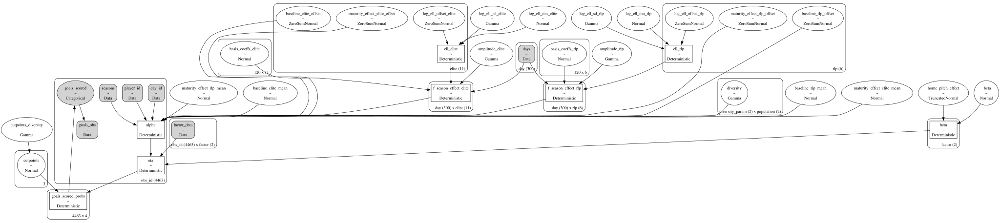

In [125]:
pm.model_to_graphviz(SFM_rlp)

## Prior Predictive Sampling

In [126]:
with SFM_rlp:
    idata = pm.sample_prior_predictive(random_seed=rng)

Sampling: [_beta, amplitude_elite, amplitude_rlp, baseline_elite_mean, baseline_elite_offset, baseline_rlp_mean, baseline_rlp_offset, basis_coeffs_elite, basis_coeffs_rlp, cutpoints, cutpoints_diversity, diversity, goals_scored, home_pitch_effect, log_ell_mu_elite, log_ell_mu_rlp, log_ell_offset_elite, log_ell_offset_rlp, log_ell_sd_elite, log_ell_sd_rlp, maturity_effect_elite_mean, maturity_effect_elite_offset, maturity_effect_rlp_mean, maturity_effect_rlp_offset]


In [127]:
idata.prior = idata.prior.rename({"goals_scored_probs_dim_1": "event"})

mindex_coords = xr.Coordinates.from_pandas_multiindex(
    complete_data.set_index(["name_player", "season", "days_since_first_game"]).index,
    "obs_id",
)

idata.prior = idata.prior.assign_coords(mindex_coords)
idata.prior_predictive = idata.prior_predictive.assign_coords(mindex_coords)
idata.observed_data = idata.observed_data.assign_coords(mindex_coords)

## Prior checks

### Prior cutpoints

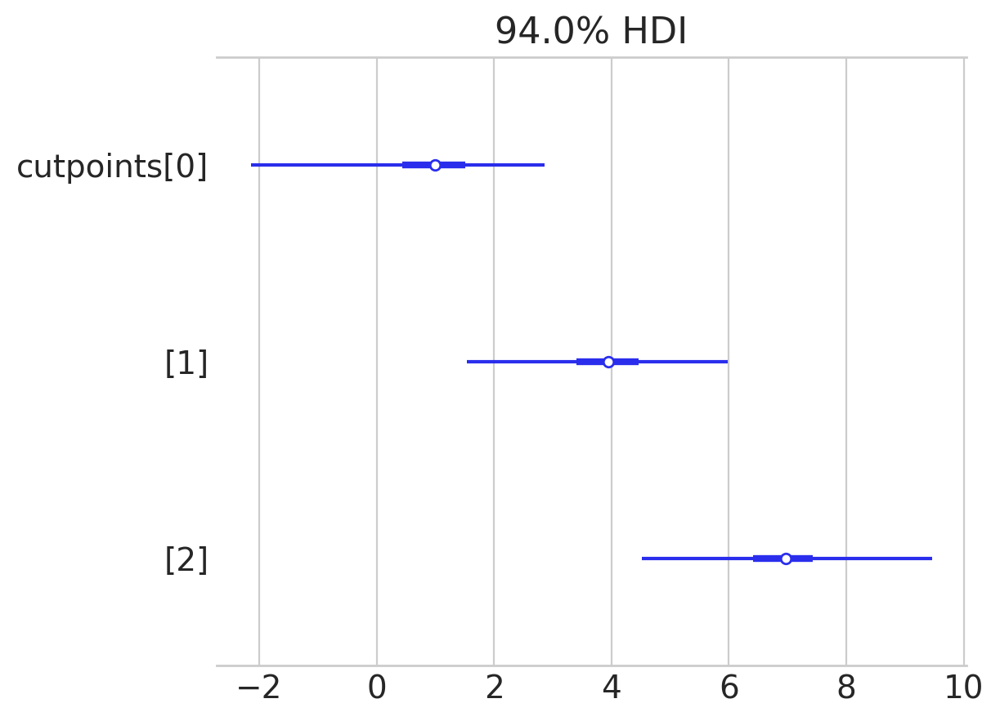

In [128]:
az.plot_forest(idata.prior["cutpoints"]);

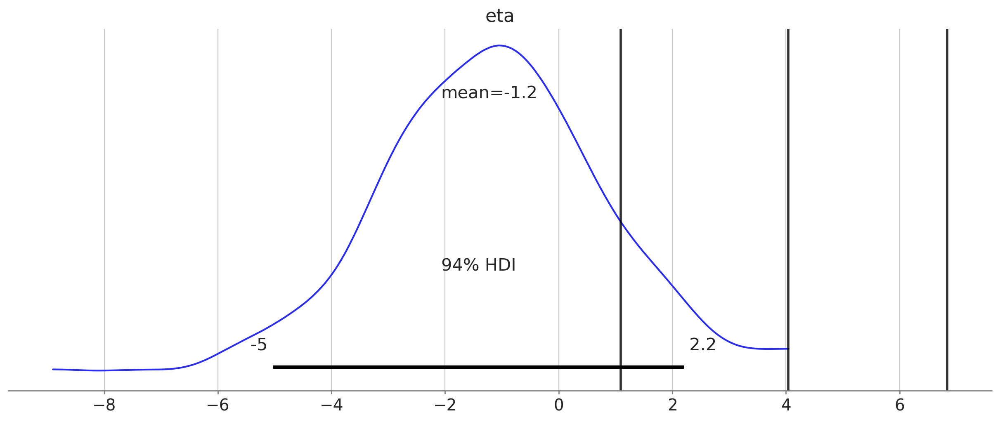

In [68]:
ax = az.plot_posterior(idata.prior["eta"].isel(obs_id=0))
for i in range(K - 1):
    ax.axvline(
        idata.prior["cutpoints"].isel(cutpoints_dim_0=i).mean().data,
        color="k",
        lw=2,
        alpha=0.8,
    )

In [69]:
implied_probs_prior = az.extract(idata.prior, var_names="goals_scored_probs").rename({"goals_scored_probs_dim_0": "obs_id"}).assign_coords(mindex_coords)

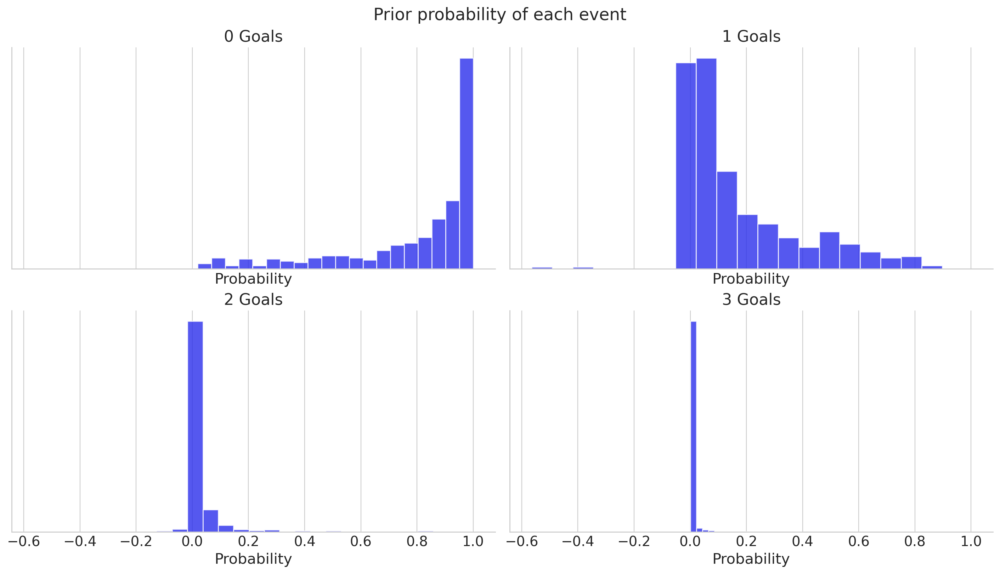

In [70]:
_, axes = plt.subplots(2, 2, figsize=(14, 8), sharex=True, layout="constrained")
axes = axes.flatten()

for i, ax in enumerate(axes):
    ax.hist(implied_probs_prior.isel(obs_id=0, event=i), ec="white", bins=20, alpha=0.8)
    ax.set(xlabel="Probability", yticklabels="", title=f"{i} Goals")
    ax.set_yticks([])
    sns.despine()
plt.suptitle("Prior probability of each event", fontsize=17);

In [71]:
implied_class = az.extract(idata.prior_predictive, var_names="goals_scored")

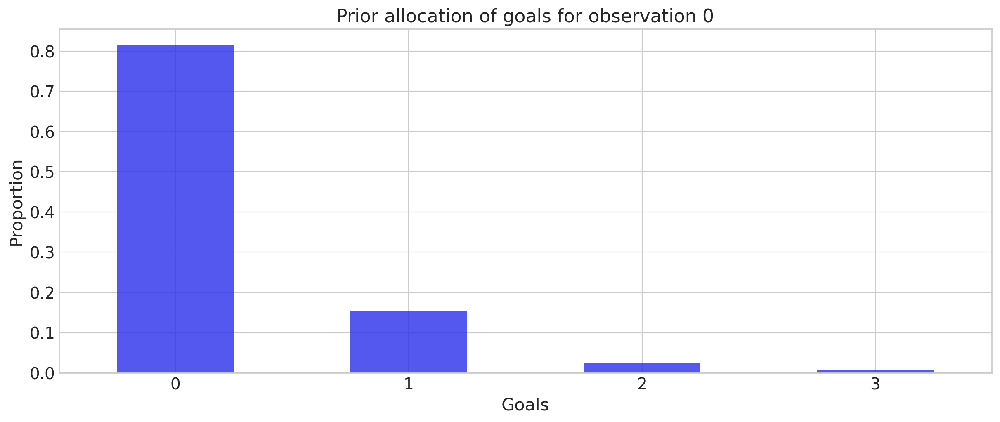

In [72]:
ax = (
    implied_class.isel(obs_id=0)
    .to_pandas()
    .reset_index(drop=True)
    .value_counts(normalize=True)
    .sort_index()
    .plot(kind="bar", rot=0, alpha=0.8)
)
ax.set(
    xlabel="Goals",
    ylabel="Proportion",
    title="Prior allocation of goals for observation 0",
);

### Prior predictive checks

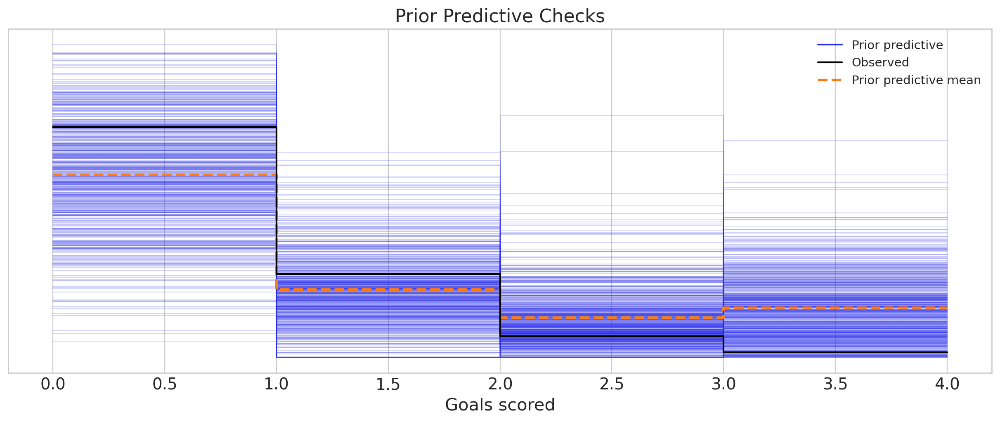

In [129]:
ax = az.plot_ppc(idata, group="prior", observed=True)
ax.set(xlabel="Goals scored", title="Prior Predictive Checks");

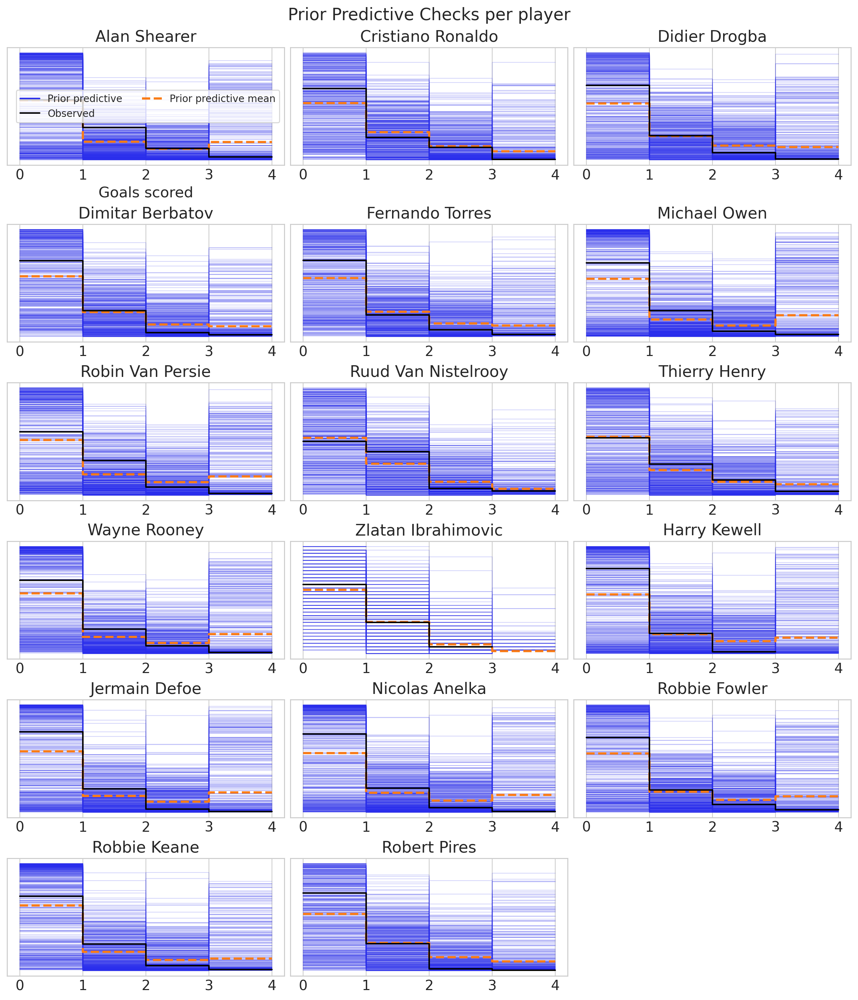

In [74]:
_, axes = plt.subplots(6, 3, figsize=(12, 14))
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    idata_plot = idata.copy()
    idata_plot.observed_data = idata.observed_data.sel(name_player=player)
    idata_plot.prior_predictive = idata.prior_predictive.sel(name_player=player)

    az.plot_ppc(idata_plot, group="prior", observed=True, ax=ax)
    ax.set(xlabel="Goals scored", yticklabels=[], title=player.title())
    if i > 0:
        ax.get_legend().remove()
        ax.set(xlabel="")
    else:
        ax.legend(ncols=2, fontsize=10, frameon=True)

plt.suptitle("Prior Predictive Checks per player", fontsize=17);

### TO UPDATE: Prior PAR

In [ ]:
with pm.Model(coords=coords) as synthetic_player:
    player_id_new = pt.random.choice(len(RLPs))

    alpha_new = (
        baseline_rlp[player_id_new]
        + maturity_effect_rlp[player_id_new] * seasons
        + within_season_effect_rlp[player_id_new] * days
    )

    eta_new = alpha_new + pm.math.dot(factor_data, beta)

    pm.OrderedLogistic(
        "goals_scored_new",
        cutpoints=cutpoints,
        eta=eta_new,
        dims="obs_id",
    )

    rlp_prior_preds = pm.sample_prior_predictive(
        var_names=["goals_scored_new"],
        random_seed=rng,
    )

In [ ]:
rlp_prior_preds.prior = rlp_prior_preds.prior.assign_coords(mindex_coords)

elite_players_prior = idata.prior_predictive["goals_scored"]
rl_players_prior = rlp_prior_preds.prior["goals_scored_new"]

par = (elite_players_prior - rl_players_prior).rename("Prior PAR").reset_index("obs_id")
elite_par_prior = par.where(par["name_player"].isin(coords["elite"]), drop=True)
rlp_par_prior = par.where(par["name_player"].isin(coords["rlp"]), drop=True)

In [ ]:
_, (left, right) = plt.subplots(1, 2, sharex=True)

az.plot_forest(
    elite_par_prior.groupby("name_player").mean("obs_id"),
    combined=True,
    ax=left,
)
left.axvline(c="k", ls="--", alpha=0.8)
left.set(title="Elite Prior PAR", xlabel="Goals")

az.plot_forest(
    rlp_par_prior.groupby("name_player").mean("obs_id"),
    combined=True,
    ax=right,
)
right.axvline(c="k", ls="--", alpha=0.8)
right.set(title="RLP Prior PAR", xlabel="Goals");

In [ ]:
_, (left, right) = plt.subplots(1, 2, sharex=True)

az.plot_forest(
    elite_par_prior.groupby("name_player").mean("obs_id"),
    combined=True,
    kind="ridgeplot",
    ridgeplot_overlap=1.5,
    ridgeplot_alpha=0.5,
    ax=left,
)

colors = sns.color_palette("viridis", n_colors=len(coords["elite"]))
# adjust colors manually
for patch, color in zip(left.collections, colors):
    patch.set_color(color)

left.axvline(c="k", ls="--", alpha=0.8)
left.set(title="Elite Prior PAR", xlabel="Goals")

az.plot_forest(
    rlp_par_prior.groupby("name_player").mean("obs_id"),
    combined=True,
    kind="ridgeplot",
    ridgeplot_overlap=1.5,
    ridgeplot_alpha=0.5,
    ax=right,
)

for patch, color in zip(right.collections, colors):
    patch.set_color(color)

right.axvline(c="k", ls="--", alpha=0.8)
right.set(title="RLP Prior PAR", xlabel="Goals");

In [ ]:
axes = az.plot_posterior(
    par.groupby("name_player").mean("obs_id"),
    kind="hist",
    grid=(6, 3),
    textsize=32,
    ref_val=0,
    ref_val_color="k",
    round_to=2,
)

# customize bar colors
colors = sns.color_palette("viridis", n_colors=len(players_ordered))
for ax, color in zip(axes.flatten(), colors[::-1]):
    for bar in ax.patches:
        bar.set_facecolor(color)

## Sampling and convergence checks

In [130]:
with SFM_rlp:
    idata.extend(pm.sample(nuts_sampler="numpyro", random_seed=rng))
    idata.extend(pm.sample_posterior_predictive(idata, random_seed=rng, compile_kwargs={"mode": "NUMBA"}))

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.12/site-packages/jax/_src/interpreters/mlir.py:930: UserWarning: Some donated buffers were not usable: ShapedArray(float64[4,1000,10]), ShapedArray(float64[4,1000,10]), ShapedArray(float64[4,1000,5]), ShapedArray(float64[4,1000,5]), ShapedArray(float64[4,1000,10]), ShapedArray(float64[4,1000,5]).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
2024-07-23 19:10:16.194386: E external/xla/xla/service/slow_operation_alarm.cc:65] Constant folding an instruction is taking > 2s:

  %reduce.2 = f64[4,1000,120,11]{3,2,1,0} reduce(f64[4,1000,1,120,11]{4,3,2,1,0} %broadcast.44, f64[] %constant.65), dimensions={2}, to_apply=%region_8.244, metadata={op_name="jit(process_fn)/jit(main)/reduce_prod[axes=(2,)]" source_file="/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/tmp1zi3c0vc" source_line=211}

This isn't necessarily a bug; constant-folding

Output()

In [131]:
idata.sample_stats.diverging.sum().data

array(0)

In [132]:
az.ess(idata).min().to_pandas().sort_values().round()

maturity_effect_elite_offset    1085.0
diversity                       1252.0
amplitude_elite                 1304.0
alpha                           1398.0
eta                             1409.0
baseline_rlp_mean               1496.0
maturity_effect_elite_mean      1501.0
cutpoints                       1505.0
baseline_elite_mean             1531.0
amplitude_rlp                   1956.0
baseline_elite_offset           2181.0
log_ell_sd_elite                2285.0
f_season_effect_elite           2376.0
goals_scored_probs              2562.0
ell_elite                       2620.0
baseline_rlp_offset             2909.0
maturity_effect_rlp_offset      3026.0
f_season_effect_rlp             3361.0
log_ell_offset_elite            3505.0
cutpoints_diversity             3624.0
ell_rlp                         3713.0
maturity_effect_rlp_mean        3795.0
log_ell_mu_elite                3808.0
log_ell_sd_rlp                  3837.0
basis_coeffs_elite              3889.0
basis_coeffs_rlp         

In [133]:
az.summary(
    idata,
    var_names=["cutpoints"],
    filter_vars="regex",
    round_to=2,
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
cutpoints[0],1.53,0.54,0.52,2.54,0.01,0.01,1505.20,1852.66,1.0
cutpoints[1],3.37,0.55,2.30,4.33,0.01,0.01,1512.06,1918.48,1.0
cutpoints[2],5.12,0.56,4.10,6.19,0.01,0.01,1551.24,2032.19,1.0
cutpoints_diversity,1.33,0.52,0.55,2.26,0.01,0.01,3624.20,3409.72,1.0


In [134]:
az.rcParams['plot.max_subplots'] = 50

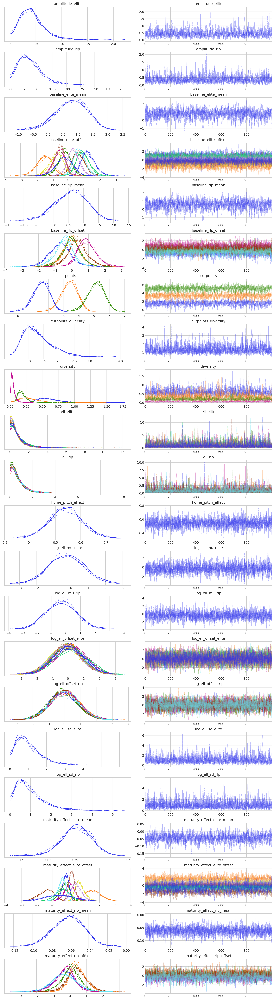

In [135]:
az.plot_trace(
    idata,
    var_names=["~alpha", "~goals_scored_probs", "~eta", "~f_season_", "~basis_coeffs"],
    filter_vars="regex",
);

In [44]:
az.plot_dist_comparison(
    idata,
    var_names=[
        "beta",
        "diversity",
        "baseline_rlp_mean",
        "maturity_effect_rlp_mean",
    ],
);

In [45]:
az.plot_dist_comparison(
    idata,
    var_names=[
        "cutpoints",
        "cutpoints_diversity",
        "amplitude_elite",
        "amplitude_rlp",
        "log_ell_mu_elite",
        "log_ell_mu_rlp",
        "log_ell_sd_elite",
        "log_ell_sd_rlp",
        "baseline_elite_mean",
        "maturity_effect_elite_mean",
    ],
);

## Posterior parameters

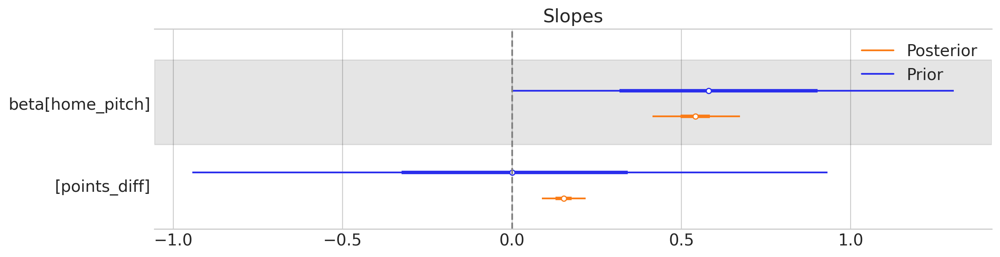

In [136]:
ax = az.plot_forest([idata.prior, idata.posterior], model_names=["Prior", "Posterior"], var_names="beta", combined=True, figsize=(12, 3))
ax[0].axvline(c="grey", ls="--")
ax[0].set(title="Slopes");

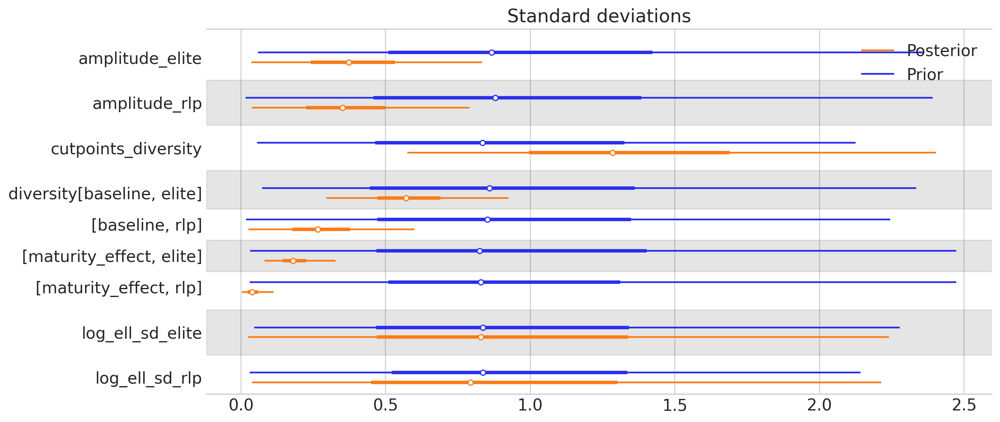

In [72]:
ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names=["diversity", "amplitude", "sd_"],
    combined=True,
    filter_vars="regex",
    figsize=(12, 5),
)
ax[0].set(title="Standard deviations");

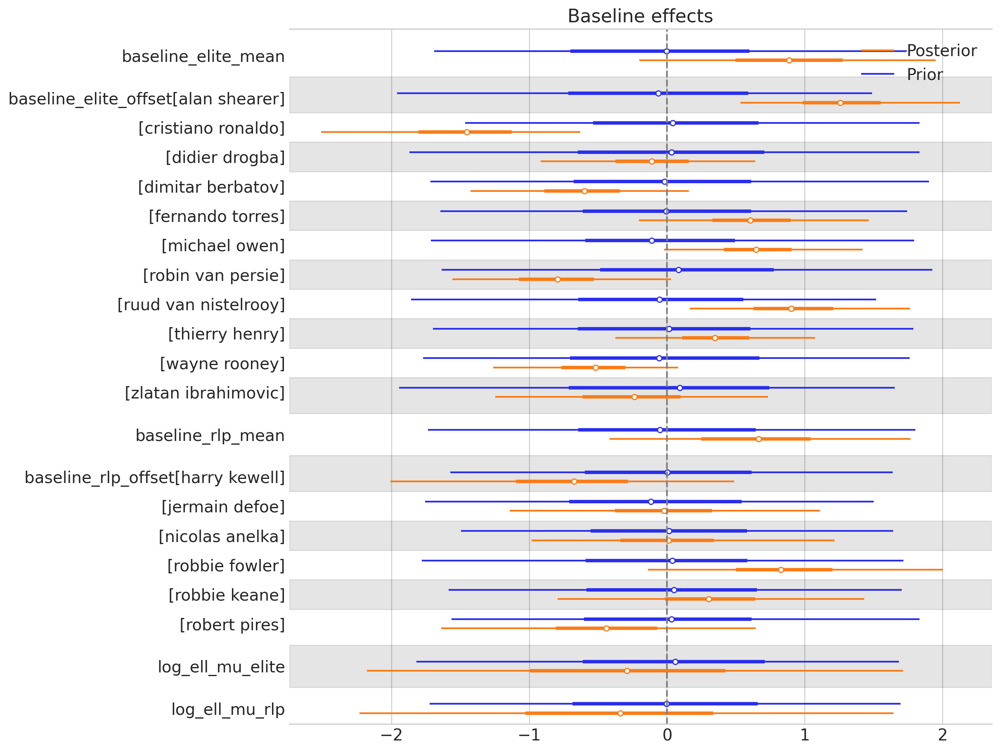

In [73]:
ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names=["baseline_", "mu_"],
    filter_vars="regex",
    combined=True,
    figsize=(12, 9),
)
ax[0].axvline(c="grey", ls="--")
ax[0].set(title="Baseline effects");

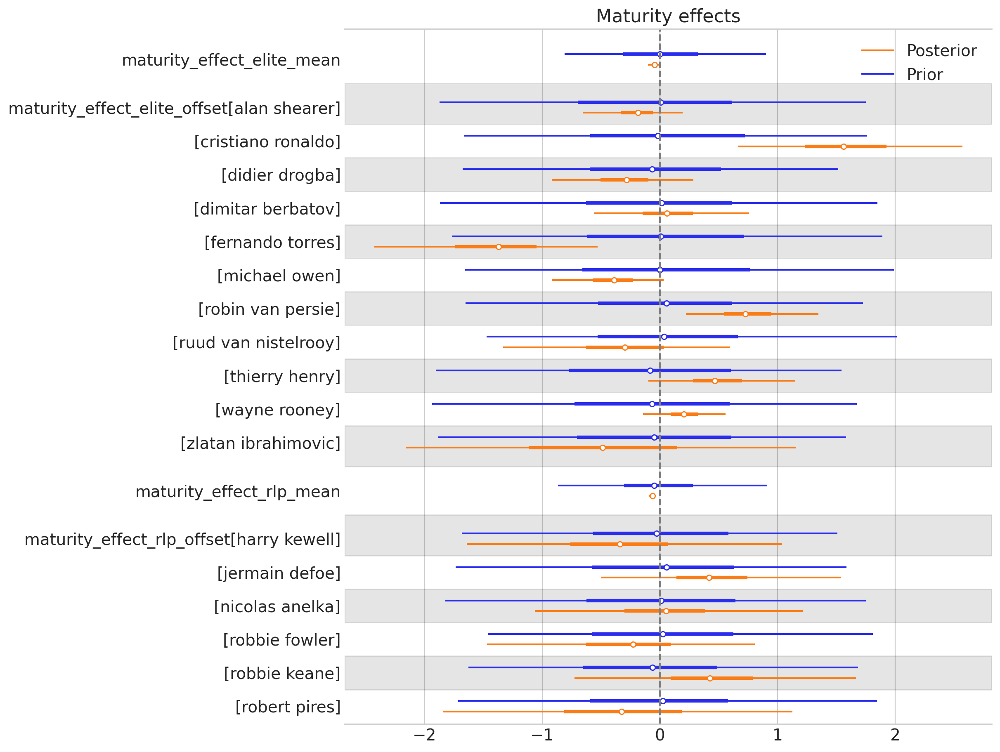

In [74]:
ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="maturity_effect",
    filter_vars="regex",
    combined=True,
    figsize=(12, 9),
)
ax[0].axvline(c="grey", ls="--")
ax[0].set(title="Maturity effects");

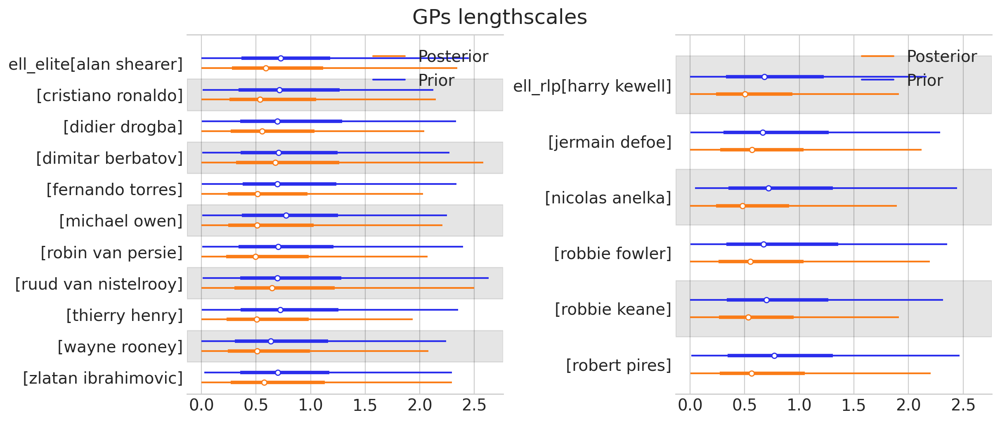

In [75]:
_, (left, right) = plt.subplots(1, 2, figsize=(12, 5), sharex=True)

ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="ell_elite",
    combined=True,
    ax=left,
)
left.set(title="")

ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="ell_rlp",
    combined=True,
    ax=right,
)
right.set(title="")

plt.suptitle("GPs lengthscales", fontsize=18);

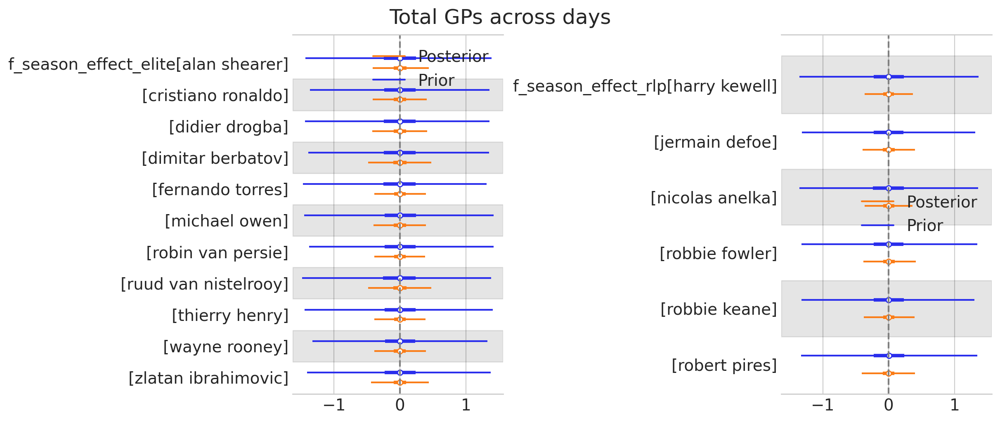

In [76]:
_, (left, right) = plt.subplots(1, 2, figsize=(12, 5), sharex=True)

ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="f_season_effect_elite",
    combined=True,
    combine_dims=set(("chain", "draw", "day")),
    ax=left,
)
left.axvline(c="grey", ls="--")
left.set(title="")

ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="f_season_effect_rlp",
    combined=True,
    combine_dims=set(("chain", "draw", "day")),
    ax=right,
)
right.axvline(c="grey", ls="--")
right.set(title="")

plt.suptitle("Total GPs across days", fontsize=18);

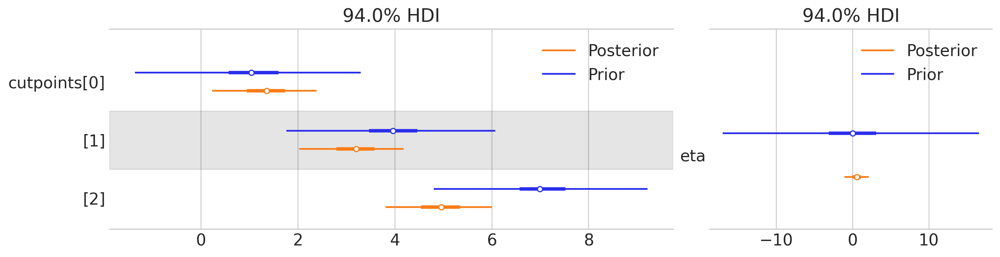

In [77]:
_, axes = plt.subplot_mosaic(
    """
    AAB
    """,
    figsize=(12, 3),
    layout="constrained",
)

az.plot_forest(
    [idata.prior["cutpoints"], idata.posterior["cutpoints"]],
    combined=True,
    model_names=["Prior", "Posterior"],
    ax=axes["A"],
)

az.plot_forest(
    [idata.prior["eta"], idata.posterior["eta"]],
    combine_dims={"chain", "draw", "obs_id"},
    combined=True,
    model_names=["Prior", "Posterior"],
    ax=axes["B"],
);

## Posterior predictive checks

In [137]:
idata.posterior = idata.posterior.rename({"goals_scored_probs_dim_1": "event"})
idata.posterior = idata.posterior.assign_coords(mindex_coords)
idata.posterior_predictive = idata.posterior_predictive.assign_coords(mindex_coords)

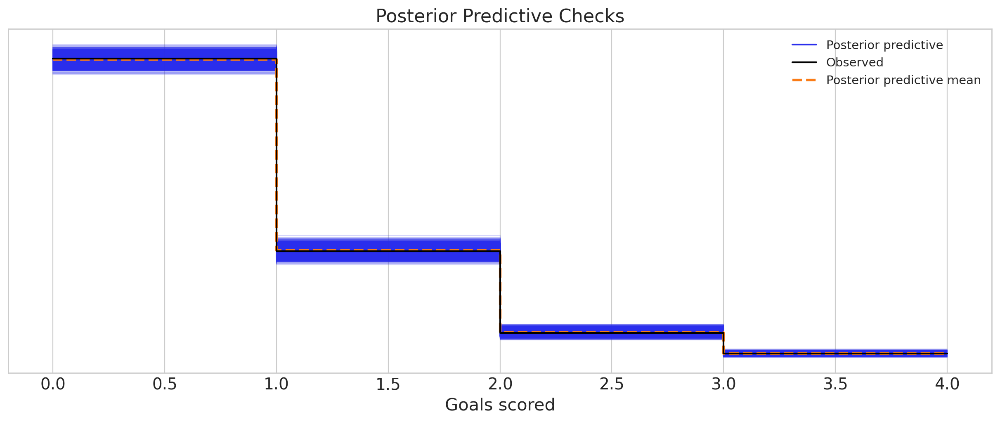

In [138]:
ax = az.plot_ppc(idata)
ax.set(xlabel="Goals scored", title="Posterior Predictive Checks");

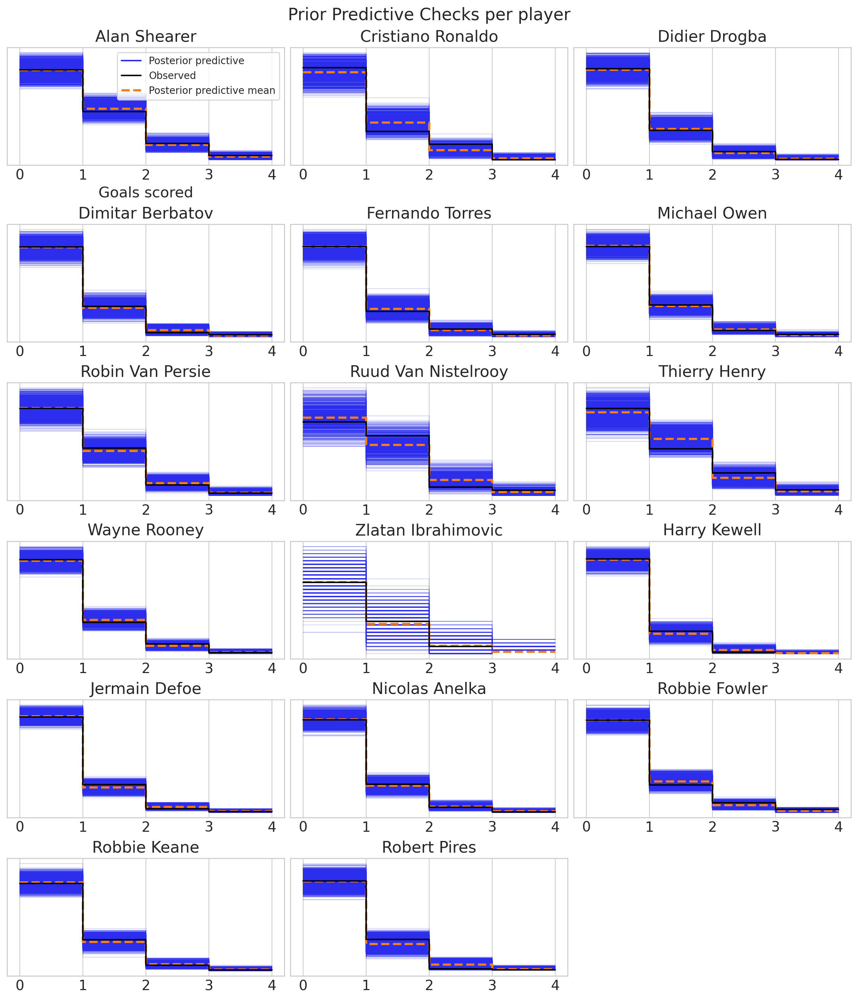

In [139]:
_, axes = plt.subplots(6, 3, figsize=(12, 14))
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    idata_plot = idata.copy()
    idata_plot.observed_data = idata.observed_data.sel(name_player=player)
    idata_plot.posterior_predictive = idata.posterior_predictive.sel(name_player=player)

    az.plot_ppc(idata_plot, ax=ax)
    ax.set(xlabel="Goals scored", yticklabels=[], title=player.title())
    if i > 0:
        ax.get_legend().remove()
        ax.set(xlabel="")
    else:
        ax.legend(fontsize=10, frameon=True)

plt.suptitle("Prior Predictive Checks per player", fontsize=17);

## Categorical probabilities

In [140]:
implied_probs_post = idata.posterior["goals_scored_probs"].rename({"goals_scored_probs_dim_0": "obs_id"}).assign_coords(mindex_coords)

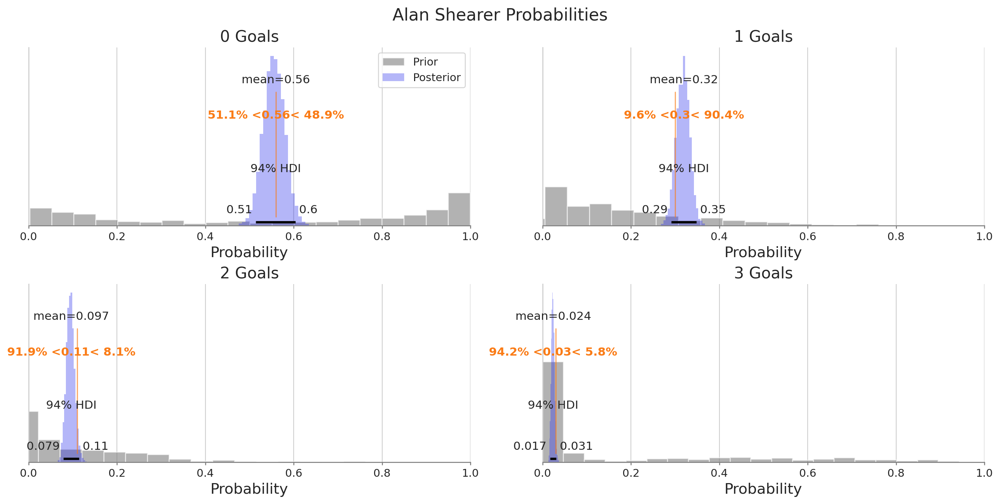

In [141]:
PLAYER = "alan shearer"
player_probs_prior = implied_probs_prior.sel(name_player=PLAYER)
player_probs_post = implied_probs_post.sel(name_player=PLAYER)
empirics = (
    idata.observed_data.sel(name_player=PLAYER)["goals_scored"]
    .to_pandas()
    .value_counts(normalize=True)
)

_, axes = plt.subplots(2, 2, figsize=(14, 7), layout="constrained")
axes = axes.flatten()

for i, ax in enumerate(axes):
    ax.hist(
        player_probs_prior.sel(event=i).mean("obs_id"),
        color="grey",
        ec="white",
        bins=20,
        alpha=0.6,
        label="Prior",
    )
    az.plot_posterior(
        player_probs_post.sel(event=i).mean("obs_id"),
        label="Posterior",
        ax=ax,
        ref_val=empirics[i].round(2),
        textsize=11,
        kind="hist",
        bins=20,
    )
    ax.set(xlabel="Probability", yticklabels="", title=f"{i} Goals", xlim=[0, 1])
    ax.set_yticks([])
    sns.despine()
    if i == 0:
        ax.legend(fontsize=11, frameon=True)
plt.suptitle(f"{PLAYER.title()} Probabilities", fontsize=17);

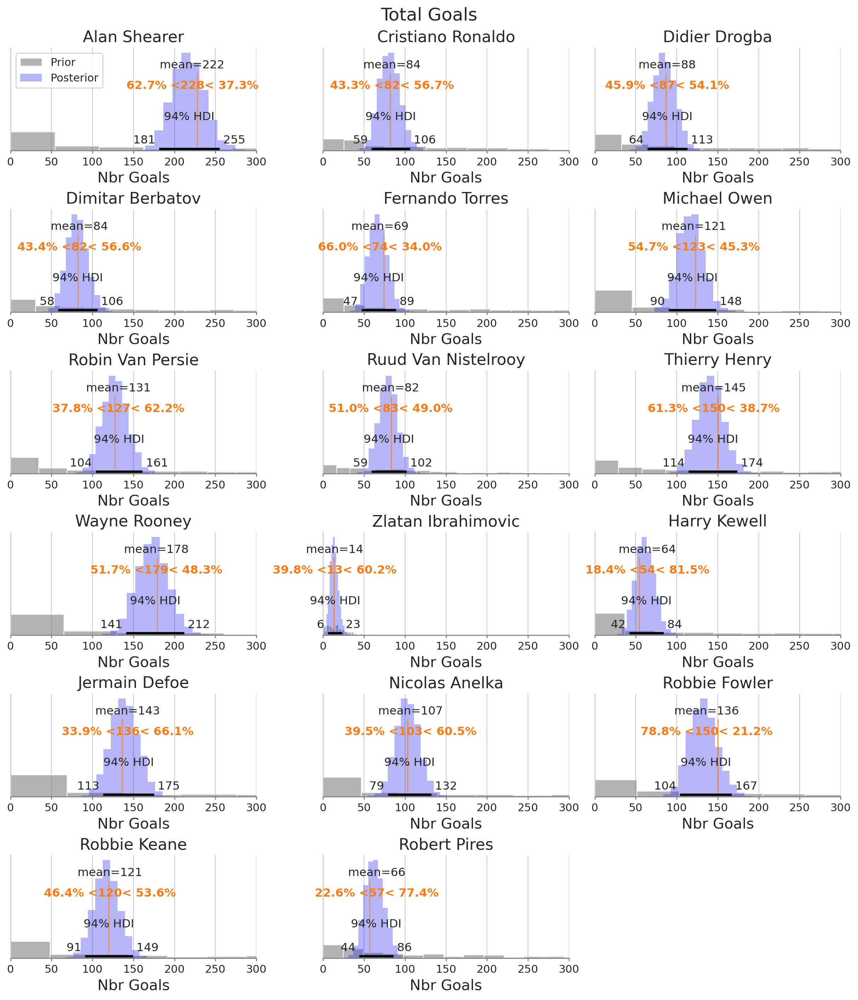

In [142]:
_, axes = plt.subplots(6, 3, figsize=(12, 14), layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    goals_prior = (
        az.extract(idata.prior_predictive, var_names="goals_scored")
        .sel(name_player=player)
        .sum("obs_id")
    )
    goals_post = (
        idata.posterior_predictive["goals_scored"].sel(name_player=player).sum("obs_id")
    )
    empirics = (
        idata.observed_data.sel(name_player=player)["goals_scored"].to_pandas().sum()
    )

    ax.hist(goals_prior, color="grey", ec="white", bins=20, alpha=0.6, label="Prior")
    az.plot_posterior(
        goals_post, label="Posterior", ax=ax, ref_val=empirics, textsize=11
    )
    ax.set(xlabel="Nbr Goals", yticklabels="", title=f"{player.title()}", xlim=[0, 300])
    ax.set_yticks([])
    sns.despine()
    if i == 0:
        ax.legend(fontsize=11, frameon=True)
plt.suptitle("Total Goals", fontsize=18);

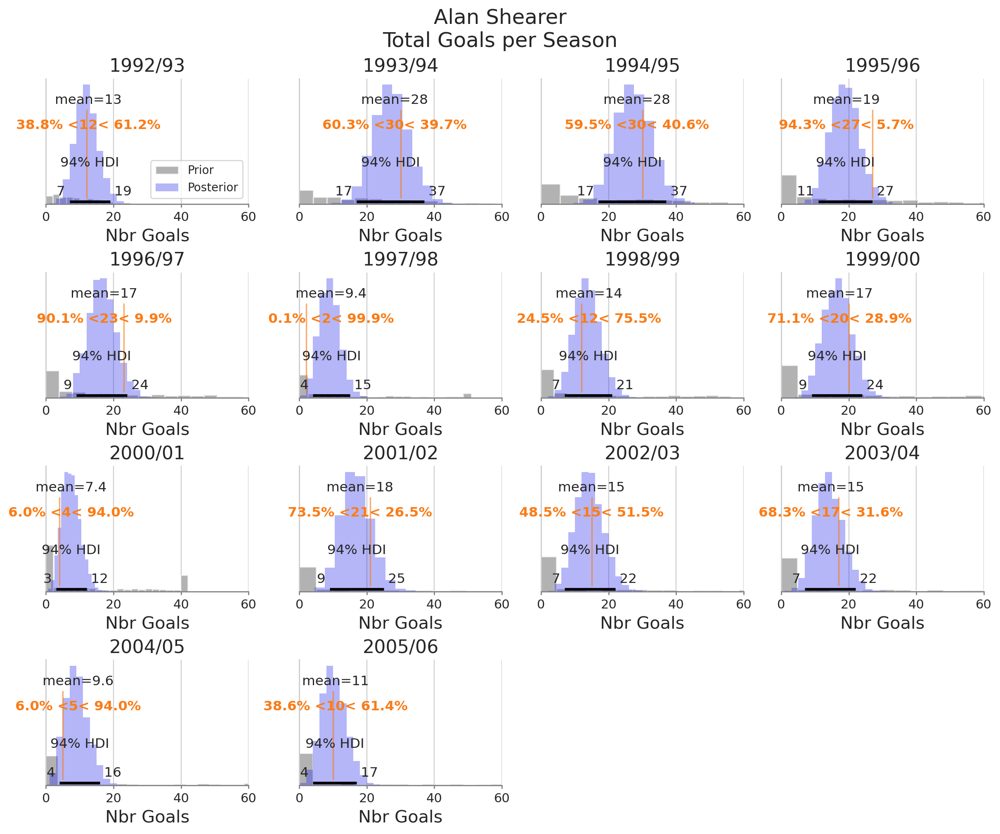

In [143]:
PLAYER = "alan shearer"
goals_prior = (
    az.extract(idata.prior_predictive, var_names="goals_scored")
    .sel(name_player=PLAYER)
    .groupby("season")
    .sum("obs_id")
)
goals_post = (
    idata.posterior_predictive["goals_scored"]
    .sel(name_player=PLAYER)
    .groupby("season")
    .sum("obs_id")
)
empirics = (
    idata.observed_data.sel(name_player=PLAYER)["goals_scored"]
    .to_pandas()
    .reset_index(name="goals")
    .groupby("season")
    .sum()["goals"]
)

unique_seasons = np.unique(goals_prior.season)
num_seasons = len(unique_seasons)

cols = 4
rows = (num_seasons + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(12, 2.5 * rows), layout="constrained")
axes = axes.flatten()

for season, (i, ax) in zip(unique_seasons, enumerate(axes)):
    ax.hist(
        goals_prior.sel(season=season),
        color="grey",
        ec="white",
        bins=20,
        alpha=0.6,
        label="Prior",
    )
    az.plot_posterior(
        goals_post.sel(season=season),
        label="Posterior",
        ax=ax,
        ref_val=empirics[season],
        textsize=11,
    )
    ax.set(xlabel="Nbr Goals", yticklabels="", title=f"{season}", xlim=[0, 60])
    ax.set_yticks([])
    sns.despine()
    if i == 0:
        ax.legend(fontsize=10, frameon=True)

# remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle(f"{PLAYER.title()}\nTotal Goals per Season", fontsize=18);

## Excess-Skill Metric

Therefore, let's have alook at the **excess-skill-metric** $S_{i,s}$. It compares each player's probability of scoring ($\hat{p}_{i,s}$) when accounting for both his ability and his team's strength ($\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}$) to the probability of him scoring when only accounting for his own skill/ability ($\hat{\alpha}_{i,s}$):

 $$ S_{i,s} = \frac{\frac{e^{\hat{\alpha}_{i,s}}}{1 \; + \; e^{\hat{\alpha}_{i,s}}}}{\frac{e^{\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}}}{1 \; + \; e^{\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}}}} \quad ,$$

where $S_{i,s} > 1$ tells us that -- according to the model -- **the player's scoring probability was dragged down by his team's performance**. Said differently, **player $i$'s full potential did not come through** while playing for that particular team in season $s$.


<br>

Since we already have stored the estimates for the numerator in `Player_Skill_season`, the only thing that is left to compute $S_{i,s}$ is the denominator.

To estimate the full model ( $\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}$ ), we could again draw all our parameter-samples from the posterior via `trace_multi.posterior` and simulate some predictions ($\hat{p}_{i,s}$) using our observed factors $\mathbf{X}_{i,s}$. But that sounds like a lot of manual work ...

<br>

... **but with [#PyMC](https://www.pymc.io/welcome.html) it's pretty easy!** The `trace_multi.posterior["p_score"]` array has already got everything what we are looking for, namely the denominator in $S_{i,s}$.

<br>

Awesome! Let's compute our $S_{i,s}$ statistic as described above:

In [ ]:
with SFM_rlp:
    pm.set_data(
        {
            "factor_data": np.zeros(idata.constant_data.factor_data.shape)
        },  # all teams are equal
    )

In [ ]:
with SFM_rlp:
    perf_alone = pm.sample_posterior_predictive(
        idata,
        var_names=["goals_scored_probs"],
        compile_kwargs={"mode": "NUMBA"},
    )

In [ ]:
perf_alone.posterior_predictive = perf_alone.posterior_predictive.rename(
    {"goals_scored_probs_dim_3": "event"}
)
perf_alone.posterior_predictive = perf_alone.posterior_predictive.assign_coords(
    mindex_coords
)

In [ ]:
prob_alone = 1 - perf_alone.posterior_predictive["goals_scored_probs"].sel(event=0)
prob_with_team = 1 - idata.posterior["goals_scored_probs"].sel(event=0)
s_metric = prob_alone / prob_with_team

<br>

So let's plot $S_{i,s}$, i.e. player $i$'s *excess-skill* in season $s$!

<br>

> Recall: $\,$ if $S_{i,s} > 1$ -- accordng to the model -- the player is *under-valued* compared to his inherent skill/ability, <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&ensp; i.e. the player actually has **excess skill** but his own team is dragging him down.

In [ ]:
filtered_seasons = complete_data.groupby("season")["name_player"].nunique().ge(3)
seasons_with_at_least_three_players = filtered_seasons[filtered_seasons].index

In [ ]:
_, axes = plt.subplots(6, 2, figsize=(14, 20), layout="constrained")
axes = axes.ravel()

for ax, season in zip(axes, seasons_with_at_least_three_players):
    s_per_season = (
        s_metric.sel(season=season)
        .groupby("name_player")
        .mean("obs_id")
        .rename("Excess Skill")
    )
    az.plot_forest(s_per_season, combined=True, ax=ax, colors="#AAC4E6")
    ax.set_title(season)
    ax.axvline(x=1, color="#70133A", alpha=0.6, ls="--", lw=2)

plt.suptitle("Has a Player been Undervalued? \n $S_{i} > 1$", fontsize=20);

<br>

But it could also be interesting to look **across seasons**! <br>
Let's just apply a summary metric (naturally the *mean* or *median*) on $S_{i,s}$ (where $S_{i,s}$ itself is either the *mean* or *median* of samples from the posterior distribution) across $s$, and get $S_{i}$, i.e. player $i$'s *excess-skill* across all seasons $s$.

In [ ]:
s_across_seasons = s_metric.groupby("name_player").mean("obs_id").rename("Excess Skill")

In [ ]:
ax = az.plot_forest(s_across_seasons, combined=True, colors="#AAC4E6")
ax[0].set_title("Has a Player been Undervalued? \n $S_{i} > 1$")
ax[0].axvline(x=1, color="#70133A", alpha=0.6, ls="--", lw=2);

To recap again: the purpose of $S_{i}$ or $S_{i,s}$ is to evaluate how a  player's probability of scoring only based on his skill/ability, $\; P\left(Y_{i,s} | \hat{\alpha}_i \right) \;$, compares to the probability of him scoring when we also account for his team's strength, $\; P\left(Y_{i,s} | \mathbf{X}_{i,s}\, , \hat{\alpha}_i \, , \hat{\beta} \right) \;$. <br>
Keep in mind that we have built these metrics based on the posterior distribution's *median* (or the *mean*) -- hence, a single point-estimate only. We haven't said anything about the uncertainty around that single number.

## Performance evolution through time

### Gaussian Process on day-of-season

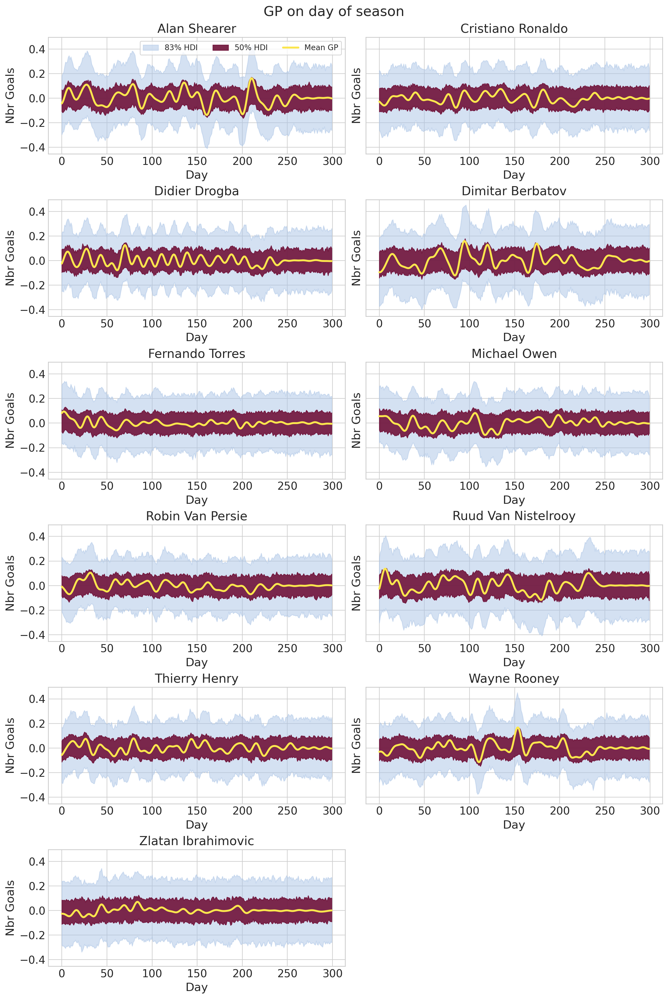

In [85]:
f_post = idata.posterior["f_season_effect_elite"]

_, axes = plt.subplots(6, 2, figsize=(12, 18), sharey=True, layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(f_post.elite.to_numpy(), enumerate(axes)):
    dates = f_post.sel(elite=player)["day"]
    y_plot = f_post.sel(elite=player)
    az.plot_hdi(
        x=dates,
        y=y_plot,
        hdi_prob=0.83,
        color="#AAC4E6",
        fill_kwargs={"alpha": 0.5, "label": r"$83\%$ HDI"},
        ax=ax,
        smooth=False,
    )
    az.plot_hdi(
        x=dates,
        y=y_plot,
        hdi_prob=0.5,
        color="#70133A",
        fill_kwargs={"alpha": 0.9, "label": r"$50\%$ HDI"},
        ax=ax,
        smooth=False,
    )
    ax.plot(
        dates, y_plot.mean(("chain", "draw")), color="#FBE64D", lw=2.5, label="Mean GP"
    )
    ax.set(xlabel="Day", ylabel="Nbr Goals", title=f"{player.title()}")
    if i == 0:
        ax.legend(fontsize=10, frameon=True, ncols=3)
plt.suptitle("GP on day of season", fontsize=18);

### Goal Probabilities per Season

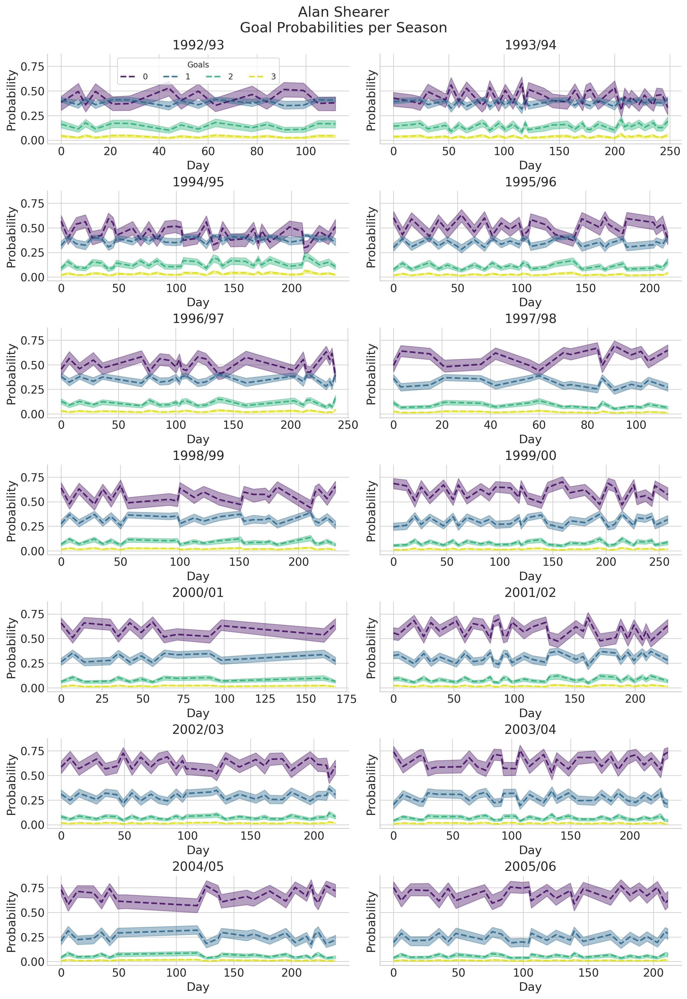

In [144]:
PLAYER = "alan shearer"
player_probs_post = implied_probs_post.sel(name_player=PLAYER)
colors = plt.cm.viridis(np.linspace(0.05, 0.95, len(coords["event"])))

cols = 2
rows = (num_seasons + cols - 1) // cols

fig, axes = plt.subplots(
    rows, cols, figsize=(12, 2.5 * rows), layout="constrained", sharey=True
)
axes = axes.flatten()

for season, (i, ax) in zip(unique_seasons, enumerate(axes)):
    dates = player_probs_post.sel(season=season)["days_since_first_game"]
    y_plot = player_probs_post.sel(season=season)

    for event in player_probs_post.event.to_numpy():
        az.plot_hdi(
            x=dates,
            y=y_plot.sel(event=event),
            hdi_prob=0.75,
            color=colors[event],
            fill_kwargs={"alpha": 0.4},
            ax=ax,
            smooth=False,
        )
        ax.plot(
            dates,
            y_plot.sel(event=event).mean(("chain", "draw")),
            lw=2,
            ls="--",
            label=f"{event}",
            color=colors[event],
            alpha=0.9,
        )

    ax.set(xlabel="Day", ylabel="Probability", title=f"{season}")
    sns.despine()
    if i == 0:
        ax.legend(fontsize=10, frameon=True, title="Goals", ncols=4)

# remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle(f"{PLAYER.title()}\nGoal Probabilities per Season", fontsize=18);

## Counterfactuals Generation

### What if all teams were equal?

In [145]:
max_nbr_games = (
    complete_data.groupby(["name_player", "season_nbr"])
    .count()["days_since_first_game"]
    .max()
)
last_game = complete_data["days_since_first_game"].max()
games_per_season = np.linspace(0, last_game, max_nbr_games, dtype=int)
unique_seasons = np.arange(complete_data["season_nbr"].max() + 1)

index = pd.MultiIndex.from_product(
    [players_ordered, unique_seasons, games_per_season],
    names=["player", "season_nbr", "days_since_first_game"],
)
unique_combinations = pd.DataFrame(index=index).reset_index()
unique_combinations

,player,season_nbr,days_since_first_game
0,alan shearer,0,0
1,alan shearer,0,7
2,alan shearer,0,14
3,alan shearer,0,21
4,alan shearer,0,28
...,...,...,...
11946,robert pires,18,231
11947,robert pires,18,238
11948,robert pires,18,245
11949,robert pires,18,252


In [146]:
with SFM_rlp:
    pm.set_data(
        coords={"obs_id": unique_combinations.index},
        new_data={
            "seasons": unique_combinations["season_nbr"].to_numpy(),
            "day_id": pd.Categorical(
                unique_combinations["days_since_first_game"],
                categories=match_days,
            ).codes,
            "player_id": pd.Categorical(
                unique_combinations["player"], categories=players_ordered
            ).codes,
            "factor_data": np.zeros(
                (len(unique_combinations), len(factors))
            ),  # all teams are equal
            "goals_obs": np.zeros(
                len(unique_combinations), dtype=int
            ),  # just a placeholder for shape inference
        },
    )

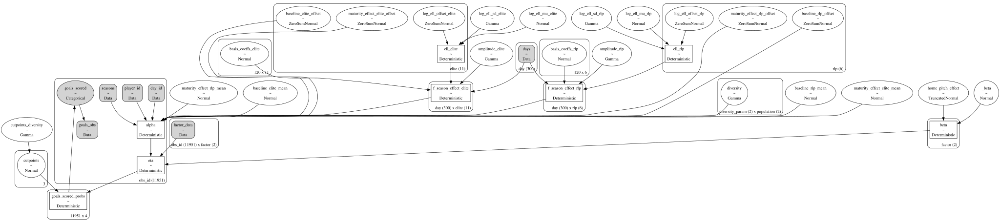

In [147]:
pm.model_to_graphviz(SFM_rlp)

In [148]:
with SFM_rlp:
    counterfact_preds = pm.sample_posterior_predictive(
        idata,
        var_names=["alpha", "goals_scored_probs", "goals_scored"],
        predictions=True,
        compile_kwargs={"mode": "NUMBA"},
    )

/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.12/site-packages/pytensor/link/numba/dispatch/basic.py:377: UserWarning: Numba will use object mode to run AdvancedSubtensor's perform method
  warnings.warn(
Sampling: [goals_scored]


Output()

In [149]:
counterfact_preds.predictions = counterfact_preds.predictions.rename({"goals_scored_probs_dim_3": "event"})

# declare the Multiindex as coordinates
mindex_coords = xr.Coordinates.from_pandas_multiindex(index, "obs_id")

# pass it as coordinates
counterfact_preds.predictions = counterfact_preds.predictions.assign_coords(mindex_coords)
counterfact_preds.predictions_constant_data = counterfact_preds.predictions_constant_data.assign_coords(
    mindex_coords
)
counterfact_preds.predictions

<xarray.Dataset> Size: 2GB
Dimensions:                   (chain: 4, draw: 1000, obs_id: 11951,
                               goals_scored_probs_dim_2: 11951, event: 4)
Coordinates:
  * chain                     (chain) int64 32B 0 1 2 3
  * draw                      (draw) int64 8kB 0 1 2 3 4 ... 995 996 997 998 999
  * goals_scored_probs_dim_2  (goals_scored_probs_dim_2) int64 96kB 0 ... 11950
  * event                     (event) int64 32B 0 1 2 3
  * obs_id                    (obs_id) object 96kB MultiIndex
  * player                    (obs_id) object 96kB 'alan shearer' ... 'robert...
  * season_nbr                (obs_id) int64 96kB 0 0 0 0 0 0 ... 18 18 18 18 18
  * days_since_first_game     (obs_id) int64 96kB 0 7 14 21 ... 238 245 252 260
Data variables:
    alpha                     (chain, draw, obs_id) float64 382MB 1.725 ... 0...
    goals_scored              (chain, draw, obs_id) int64 382MB 0 1 0 ... 0 1 0
    goals_scored_probs        (chain, draw, goals_scored_probs_dim_2, event) float64 2GB ...
Attributes:
    created_at:                 2024-07-24T10:05:32.334406+00:00
    arviz_version:              0.18.0
    inference_library:          pymc
    inference_library_version:  5.16.2

#### Scoring Probabilities

In [150]:
implied_probs_preds = counterfact_preds.predictions["goals_scored_probs"].rename({"goals_scored_probs_dim_2": "obs_id"}).assign_coords(mindex_coords)

In [151]:
n_seasons = complete_data.groupby(["name_player"])["season"].nunique().sort_values()
probs_preds = az.extract(implied_probs_preds, var_names="goals_scored_probs")
dates = np.unique(probs_preds["season_nbr"].to_numpy())
player_data = (
    complete_data.groupby(["name_player", "season_nbr"])["goal"]
    .value_counts(normalize=True)
    .sort_index()
    .reset_index(level=[1, 2])
)
player_data = player_data[player_data.goal == 1].drop("goal", axis=1)

<>:39: SyntaxWarning: invalid escape sequence '\g'
<>:39: SyntaxWarning: invalid escape sequence '\g'
/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_22290/4259474751.py:39: SyntaxWarning: invalid escape sequence '\g'
  plt.suptitle("$P(goal \geq 1)$\nMid-season Projection", fontsize=18);


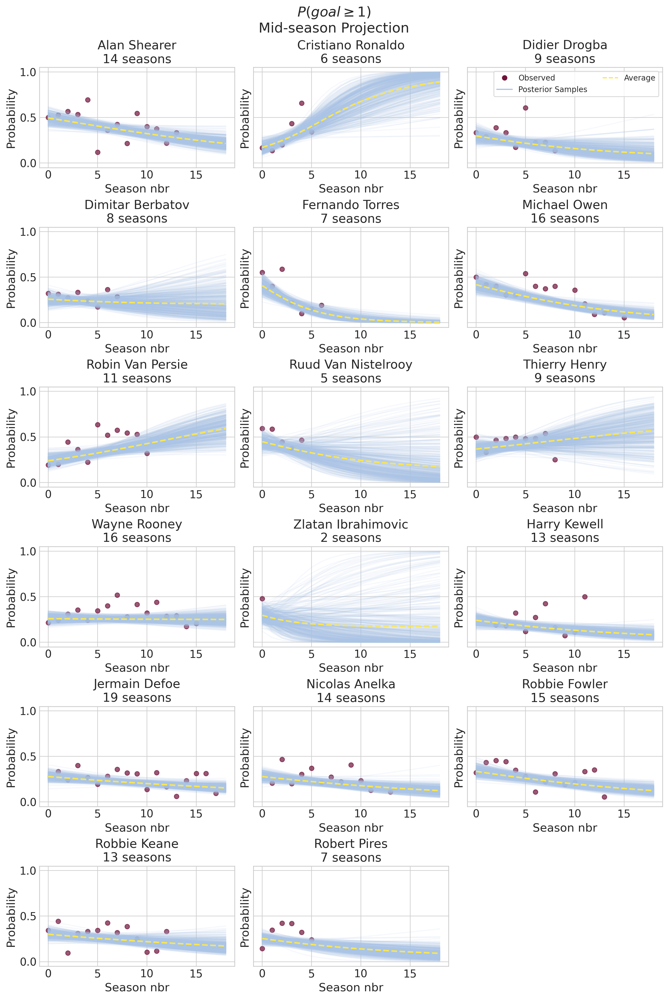

In [152]:
_, axes = plt.subplots(6, 3, figsize=(12, 18), sharey=True, layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    player_scoring_prob = 1 - probs_preds.sel(player=player, event=0).groupby(
        "season_nbr"
    ).mean("obs_id")

    ax.plot(
        dates,
        player_scoring_prob.sel(sample=slice(None, None, 10)),
        color="#AAC4E6",
        alpha=0.1,
    )
    ax.plot(dates, player_scoring_prob.mean("sample"), color="#FBE64D", lw=2, ls="--")
    ax.scatter(
        player_data.loc[player, "season_nbr"],
        player_data.loc[player, "proportion"],
        color="#70133A",
        alpha=0.7,
    )

    ax.set(
        title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
        xlabel="Season nbr",
        ylabel="Probability",
    )
    if i == 2:
        handles = [
            Line2D(
                [], [], color="#70133A", marker="o", linestyle="None", label="Observed"
            ),
            Line2D([], [], color="#AAC4E6", label="Posterior Samples"),
            Line2D([], [], color="#FBE64D", ls="--", label="Average"),
        ]
        ax.legend(handles=handles, fontsize=10, frameon=True, ncols=2)

plt.suptitle("$P(goal \geq 1)$\nMid-season Projection", fontsize=18);

#### Scoring Rates

Compute expected goals per match for each posterior sample (assuming 3+ goals is treated as exactly 3 goals).

In [153]:
expected_goals = (
    (
        1 * implied_probs_preds.sel(event=1)
        + 2 * implied_probs_preds.sel(event=2)
        + 3 * implied_probs_preds.sel(event=3)
    )
    .unstack("obs_id")
    .rename("expected_goals")
)
player_data = complete_data.set_index("name_player")

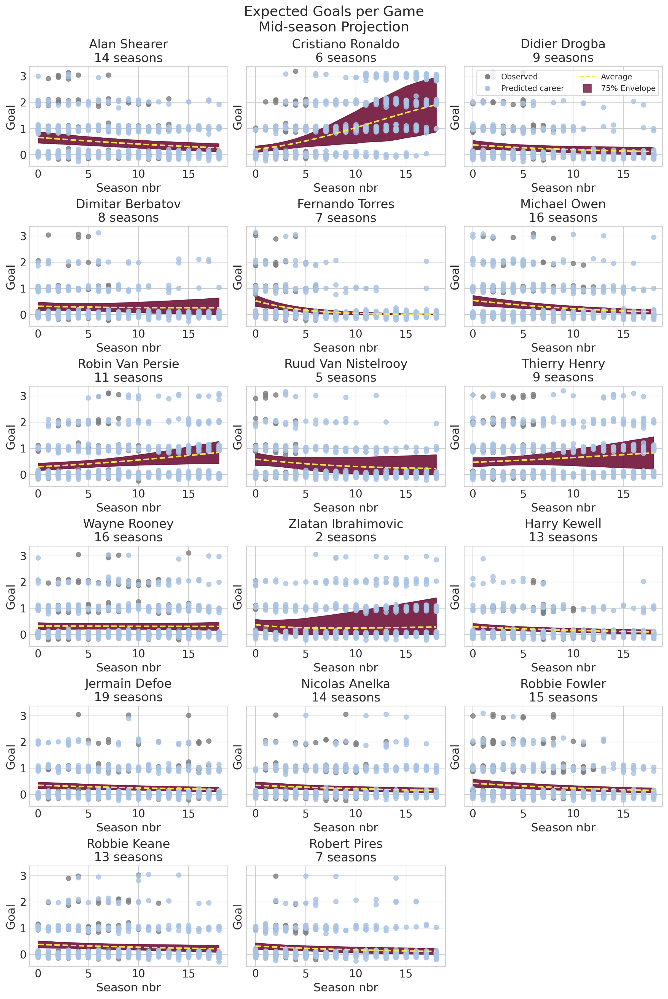

In [154]:
_, axes = plt.subplots(6, 3, figsize=(12, 18), sharey=True, layout="constrained")
axes = axes.flatten()
axes[-1].remove()
jitter_strength = 0.07

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    player_scoring_rate = expected_goals.sel(player=player)
    player_preds = az.extract(counterfact_preds.predictions.sel(player=player))["goals_scored"].sel(
        sample=(
            rng.choice(counterfact_preds.predictions.chain),
            rng.choice(counterfact_preds.predictions.draw),
        ),
    )

    ax.plot(
        player_preds["season_nbr"],
        player_preds + rng.normal(0, jitter_strength, player_preds.shape),
        marker="o",
        linestyle="None",
        color="#AAC4E6",
        alpha=0.8,
    )
    az.plot_hdi(
        dates,
        hdi_data=az.hdi(
            player_scoring_rate, input_core_dims=[["chain", "draw", "days_since_first_game"]]
        ),
        hdi_prob=0.75,
        ax=ax,
        smooth=False,
        color="#70133A",
        fill_kwargs={"alpha": 0.9},
    )
    ax.plot(
        dates,
        player_scoring_rate.mean(["chain", "draw", "days_since_first_game"]),
        color="#FBE64D",
        lw=2,
        ls="--",
    )
    ax.scatter(
        player_data.loc[player, "season_nbr"],
        player_data.loc[player, "goals_cats"]
        + rng.normal(0, jitter_strength, len(player_data.loc[player, "goals_cats"])),
        c="grey",
        alpha=0.8,
    )

    ax.set(
        title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
        xlabel="Season nbr",
        ylabel="Goal",
    )
    if i == 2:
        handles = [
            Line2D(
                [], [], color="grey", marker="o", linestyle="None", label="Observed"
            ),
            Line2D(
                [],
                [],
                color="#AAC4E6",
                marker="o",
                linestyle="None",
                label="Predicted career",
            ),
            Line2D([], [], color="#FBE64D", ls="--", label="Average"),
            Line2D(
                [],
                [],
                color="#70133A",
                alpha=0.8,
                marker="s",
                markersize=10,
                linestyle="None",
                label="75% Envelope",
            ),
        ]
        ax.legend(handles=handles, fontsize=10, frameon=True, ncols=2)

plt.suptitle("Expected Goals per Game\nMid-season Projection", fontsize=18);

### What if Henry went to Aston Villa instead of Barcelona?

1. A constant question decision-makers have is: __What would this player's performance be if we hired him in our team?__ I think we can already do that: for a given player (the one we're interested in), replace the factor data he's originally linked to by the factor data of his new potential team; then sample posterior predictive performance, and boom! Do you agree we can already do that?

2. In the same vein, __counterfactual study__: Let's take this transfer from player A to team X (that actually happened), make model predictions and compare to the observed performance of the player in team X. Then, simulate he was instead transferred to team Y, and see how his performance changes (i.e __what if he had been traded to that other team instead?__).

--> [interrupted time series](https://www.pymc.io/projects/examples/en/latest/causal_inference/interrupted_time_series.html)

- SCORES MORE GOALS THAN TOTAL TEAM OBSERVED PER GAME? --> NEED UPPER BOUND ON PLAYER EQUAL TO TOTAL OF TEAM

In [172]:
data_by_team = pd.read_csv("../../10_data/101_SFM/SFM_data_by_team.csv").rename(columns={"points_diff_team_opp": "points_diff"})

In [164]:
class CounterfactualsFactory:
    def __init__(self, complete_data: pd.DataFrame, data_by_team: pd.DataFrame, factors: list, scaler: StandardScaler):
        self.complete_data = complete_data
        self.data_by_team = data_by_team
        self.factors = factors
        self.scaler = scaler

    def isolate_player(self, player_name: str) -> pd.DataFrame:
        """
        Isolate data for a specific player.

        Parameters:
        -----------
        player_name : str
            The name of the player to isolate.

        Returns:
        --------
        pd.DataFrame
            A DataFrame containing data for the specified player with the 'kickoff_dt' normalized.
        """
        player_data = self.complete_data[self.complete_data["name_player"] == player_name]
        player_data["kickoff_dt"] = player_data["kickoff_dt"].dt.normalize()
        
        self.player_data = player_data[
            ["name_player", "season", "season_nbr", "kickoff_dt", "days_since_first_game", "goals_cats"] + self.factors
        ].reset_index(drop=True)

        return self.player_data

    def select_team_seasons(self, team_name: str, start_season: str, end_season: str) -> pd.DataFrame:
        """
        Select data for a specific team and seasons, normalize date and standardize factors.

        Parameters:
        -----------
        team_name : str
            The name of the team to select.
        start_season : str
            The start season in the format 'YYYY/YY'. Not included in selection.
        end_season : str
            The end season in the format 'YYYY/YY'. Not included in selection.

        Returns:
        --------
        pd.DataFrame
            A DataFrame containing data for the specified team and seasons with normalized dates and standardized factors.
        """
        team_data = self.data_by_team.loc[
            (self.data_by_team["name_team"] == team_name) &
            (self.data_by_team["season"] > start_season) &
            (self.data_by_team["season"] < end_season)
        ]
        team_data["kickoff_dt"] = pd.to_datetime(team_data["kickoff"], yearfirst=True).dt.normalize()
        
        max_season_nbr = self.player_data.loc[self.player_data["season"] == start_season, "season_nbr"].iloc[-1] + 1
        team_data["season_nbr"] = team_data["season"].factorize(sort=True)[0] + max_season_nbr
        
        team_data["days_since_first_game"] = team_data.groupby("season")["kickoff_dt"].transform(lambda x: (x - x.min()).dt.days)
        
        selected_columns = ["season", "season_nbr", "kickoff_dt", "days_since_first_game"] + self.factors
        team_data = team_data[selected_columns].reset_index(drop=True)
        
        # Standardize factors using the fitted scaler
        team_data[factors_numeric] = self.scaler.transform(team_data[factors_numeric])
        
        return team_data

In [173]:
counterfactuals_factory = CounterfactualsFactory(complete_data, data_by_team, factors, scaler)
th_data = counterfactuals_factory.isolate_player("thierry henry")
# remove Henry's 2012 comeback
th_data = th_data[th_data["season"] <= "2006/07"]
th_data

/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_22290/3079460964.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  player_data["kickoff_dt"] = player_data["kickoff_dt"].dt.normalize()


,name_player,season,season_nbr,kickoff_dt,days_since_first_game,goals_cats,home_pitch,points_diff
0,thierry henry,1999/00,0,1999-08-28,0,0,0.0,4.0
1,thierry henry,1999/00,0,1999-09-11,14,0,1.0,-3.0
2,thierry henry,1999/00,0,1999-09-18,21,1,0.0,4.0
3,thierry henry,1999/00,0,1999-09-25,28,0,1.0,7.0
4,thierry henry,1999/00,0,1999-10-03,36,0,0.0,6.0
...,...,...,...,...,...,...,...,...
213,thierry henry,2006/07,7,2007-01-02,94,1,1.0,20.0
214,thierry henry,2006/07,7,2007-01-13,105,1,0.0,11.0
215,thierry henry,2006/07,7,2007-01-21,113,1,1.0,-15.0
216,thierry henry,2006/07,7,2007-02-03,126,1,0.0,14.0


In [174]:
av_data = counterfactuals_factory.select_team_seasons("aston villa", "2006/07", "2011/12")
av_data

/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_22290/3079460964.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  team_data["kickoff_dt"] = pd.to_datetime(team_data["kickoff"], yearfirst=True).dt.normalize()
/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_22290/3079460964.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  team_data["season_nbr"] = team_data["season"].factorize(sort=True)[0] + max_season_nbr
/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_22290/30794609

,season,season_nbr,kickoff_dt,days_since_first_game,home_pitch,points_diff
0,2007/08,8,2007-08-11,0,1.0,-0.575788
1,2007/08,8,2007-08-18,7,0.0,-0.780810
2,2007/08,8,2007-08-25,14,1.0,-0.712470
3,2007/08,8,2007-09-02,22,1.0,-0.985832
4,2007/08,8,2007-09-16,36,0.0,-0.712470
...,...,...,...,...,...,...
147,2010/11,11,2011-04-23,252,1.0,-0.439107
148,2010/11,11,2011-04-30,259,0.0,-0.507448
149,2010/11,11,2011-05-07,266,1.0,-0.165745
150,2010/11,11,2011-05-15,274,0.0,-2.284303


In [99]:
# nbr goals scored in game N
data_by_team.groupby(["name_team", "season"])["goalsscored_cum_team"].diff()

0        NaN
1        1.0
2        0.0
3        1.0
4        1.0
        ... 
22527    0.0
22528    2.0
22529    1.0
22530    1.0
22531    3.0
Name: goalsscored_cum_team, Length: 22532, dtype: float64

In [117]:
# select Arsenal during Henry's tenure in FCB

ars_data = data_by_team.loc[
    (data_by_team["name_team"] == "arsenal")
    & (data_by_team["season"] > "2006/07")
    & (data_by_team["season"] < "2011/12")
]

ars_data["kickoff_dt"] = pd.to_datetime(
    ars_data["kickoff"], yearfirst=True
).dt.normalize()

# compute season number
ars_data["season_nbr"] = ars_data["season"].factorize(sort=True)[0] + th_data.loc[th_data["season"] == "2006/07", "season_nbr"].iloc[-1] + 1

# compute days since first game of season
ars_data["days_since_first_game"] = ars_data.groupby("season")["kickoff_dt"].transform(lambda x: (x - x.min()).dt.days)

ars_data = ars_data[
    ["season", "season_nbr", "kickoff_dt", "days_since_first_game"]
    + factors
].reset_index(drop=True)

ars_data[factors] = (ars_data[factors] - factors_mean) / factors_sd
ars_data

/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_20131/2043995618.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ars_data["kickoff_dt"] = pd.to_datetime(
/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_20131/2043995618.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ars_data["season_nbr"] = ars_data["season"].factorize(sort=True)[0] + th_data.loc[th_data["season"] == "2006/07", "season_nbr"].iloc[-1] + 1
/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_20131/20439956

,season,season_nbr,kickoff_dt,days_since_first_game,goalsscored_rank_team,home_pitch,goalsconceded_rank_opp,goal_balance_diff
0,2007/08,8,2007-08-12,0,2.363929,0.982783,-0.919209,-0.650398
1,2007/08,8,2007-08-19,7,2.049006,-1.017290,-1.005357,-0.650398
2,2007/08,8,2007-08-25,13,1.419162,0.982783,-1.522242,-0.840626
3,2007/08,8,2007-09-02,21,1.839058,0.982783,0.286856,-0.745512
4,2007/08,8,2007-09-15,34,0.369420,-1.017290,0.803741,-0.697955
...,...,...,...,...,...,...,...,...
147,2010/11,11,2011-04-24,252,-0.680321,-1.017290,-0.057734,-0.697955
148,2010/11,11,2011-05-01,259,-0.680321,0.982783,-1.177652,-2.505116
149,2010/11,11,2011-05-08,266,-0.680321,-1.017290,-0.488472,-0.507728
150,2010/11,11,2011-05-15,273,-0.680321,0.982783,0.889889,0.062955


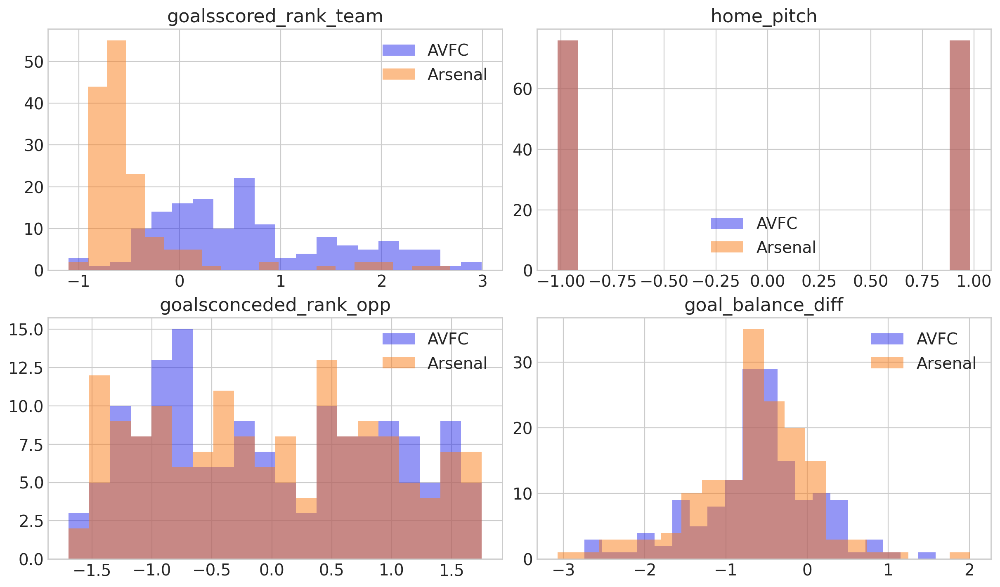

In [118]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7), layout="constrained")
axes = axes.flatten()

for (i, factor) in enumerate(factors):
    axes[i].hist(av_data[factor], alpha=0.5, bins=20, label="AVFC")
    axes[i].hist(ars_data[factor], alpha=0.5, bins=20, label="Arsenal")
    axes[i].legend()
    axes[i].set(title=factor)

In [102]:
with SFM_rlp:
    pm.set_data(
        coords={"obs_id": av_data.index},
        new_data={
            "seasons": av_data["season_nbr"].to_numpy(),
            "day_id": pd.Categorical(
                av_data["days_since_first_game"], 
                categories=match_days
            ).codes,
            "player_id": np.full_like(
                av_data["season_nbr"], 
                fill_value=players_ordered.get_loc("thierry henry"),
            ),
            "factor_data": av_data[factors],
            "goals_obs": np.zeros(
                len(av_data), dtype=int
            ),  # just a placeholder for shape inference
        },
    )

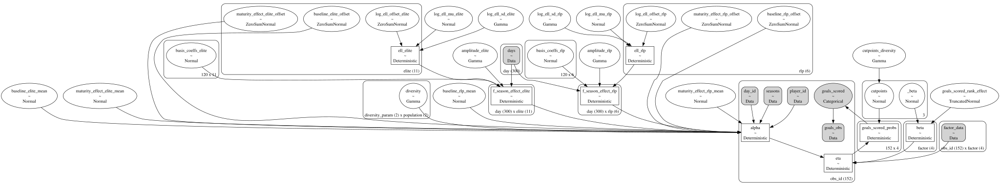

In [103]:
pm.model_to_graphviz(SFM_rlp)

In [104]:
with SFM_rlp:
    th_preds = pm.sample_posterior_predictive(
        idata,
        var_names=["goals_scored_probs", "goals_scored"],
        predictions=True,
        compile_kwargs={"mode": "NUMBA"},
    )

/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.12/site-packages/pytensor/link/numba/dispatch/basic.py:377: UserWarning: Numba will use object mode to run AdvancedSubtensor's perform method
  warnings.warn(
Sampling: [goals_scored]


Output()

In [105]:
th_preds.predictions = th_preds.predictions.rename({"goals_scored_probs_dim_3": "event"})

mindex_coords_counterfact = xr.Coordinates.from_pandas_multiindex(
    av_data.set_index(["season", "days_since_first_game"]).index,
    "obs_id",
)

th_preds.predictions = th_preds.predictions.assign_coords(mindex_coords_counterfact)
th_preds.predictions_constant_data = th_preds.predictions_constant_data.assign_coords(
    mindex_coords_counterfact
)
th_preds.predictions

<xarray.Dataset> Size: 24MB
Dimensions:                   (chain: 4, draw: 1000, obs_id: 152,
                               goals_scored_probs_dim_2: 152, event: 4)
Coordinates:
  * chain                     (chain) int64 32B 0 1 2 3
  * draw                      (draw) int64 8kB 0 1 2 3 4 ... 995 996 997 998 999
  * goals_scored_probs_dim_2  (goals_scored_probs_dim_2) int64 1kB 0 1 ... 151
  * event                     (event) int64 32B 0 1 2 3
  * obs_id                    (obs_id) object 1kB MultiIndex
  * season                    (obs_id) object 1kB '2007/08' ... '2010/11'
  * days_since_first_game     (obs_id) int64 1kB 0 7 14 22 ... 259 266 274 281
Data variables:
    goals_scored              (chain, draw, obs_id) int64 5MB 0 1 1 0 ... 2 1 0
    goals_scored_probs        (chain, draw, goals_scored_probs_dim_2, event) float64 19MB ...
Attributes:
    created_at:                 2024-07-23T10:41:52.544346+00:00
    arviz_version:              0.18.0
    inference_library:          pymc
    inference_library_version:  5.16.2

In [106]:
ars_est = idata.posterior_predictive.sel(name_player="thierry henry")["goals_scored"].groupby("season").mean("obs_id")
av_est = th_preds.predictions["goals_scored"].groupby("season").mean("obs_id")
th_goals_preds = xr.merge([ars_est, av_est])

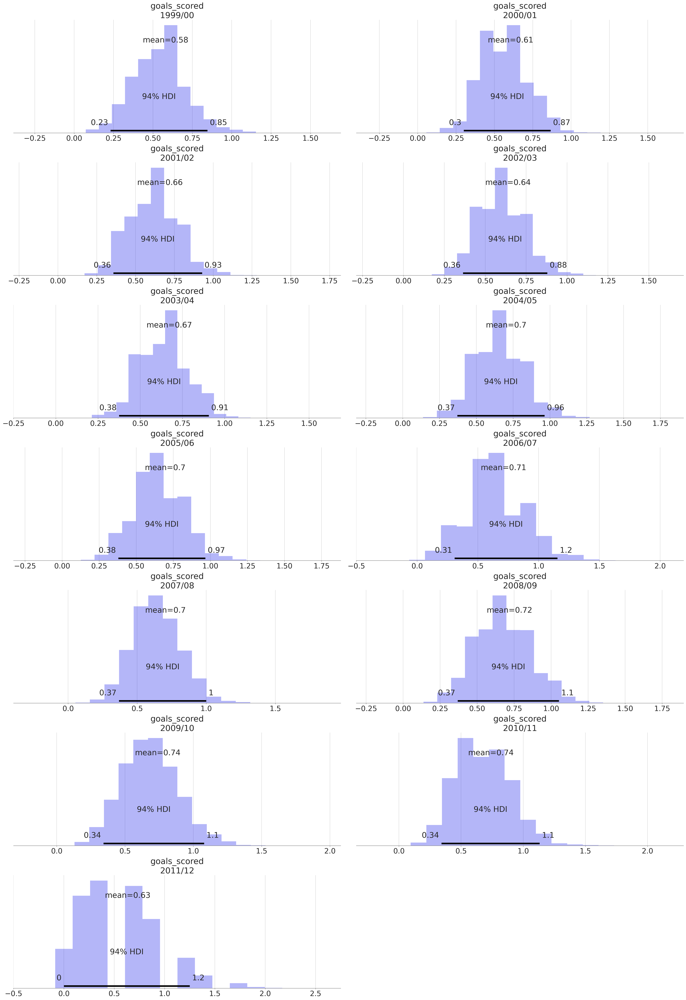

In [107]:
az.plot_posterior(th_goals_preds, kind="hist", grid=(7, 2), textsize=21);

<>:24: SyntaxWarning: invalid escape sequence '\G'
<>:24: SyntaxWarning: invalid escape sequence '\G'
/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_20131/4053462402.py:24: SyntaxWarning: invalid escape sequence '\G'
  plt.suptitle("Thierry Henryn\Goals per 90'", fontsize=18);


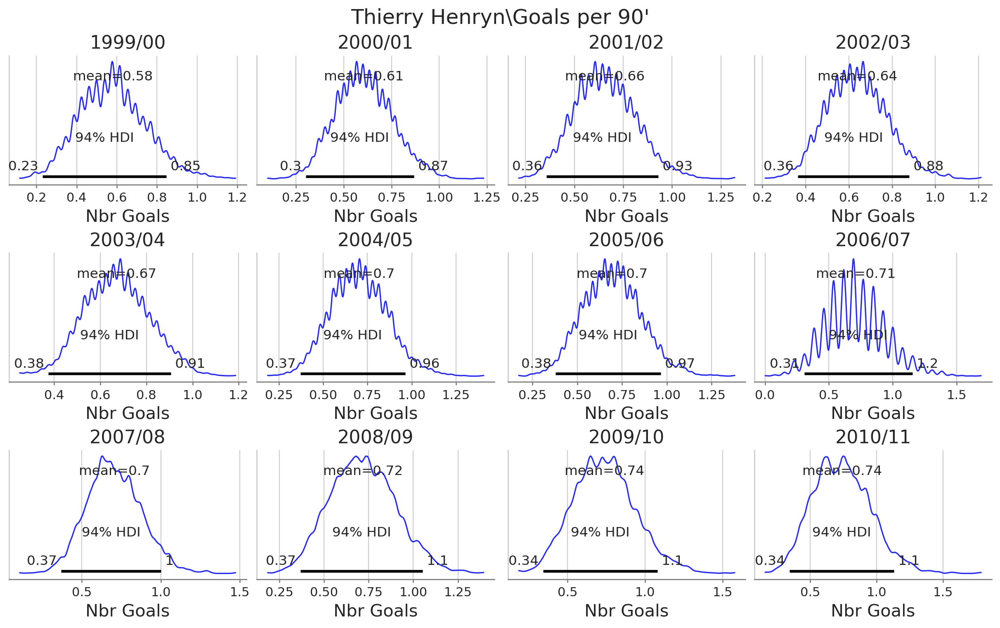

In [108]:
unique_seasons = np.concatenate([th_data.season.unique(), np.unique(av_data.season)])
num_seasons = len(unique_seasons)

cols = 4
rows = (num_seasons + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(12, 2.5 * rows), layout="constrained")
axes = axes.flatten()

for season, (i, ax) in zip(unique_seasons, enumerate(axes)):
    az.plot_posterior(
        th_goals_preds.sel(season=season),
        ax=ax,
        textsize=11,
    )
    ax.set(xlabel="Nbr Goals", yticklabels="", title=f"{season}",)
    ax.set_yticks([])
    sns.despine()

# remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle("Thierry Henryn\Goals per 90'", fontsize=18);

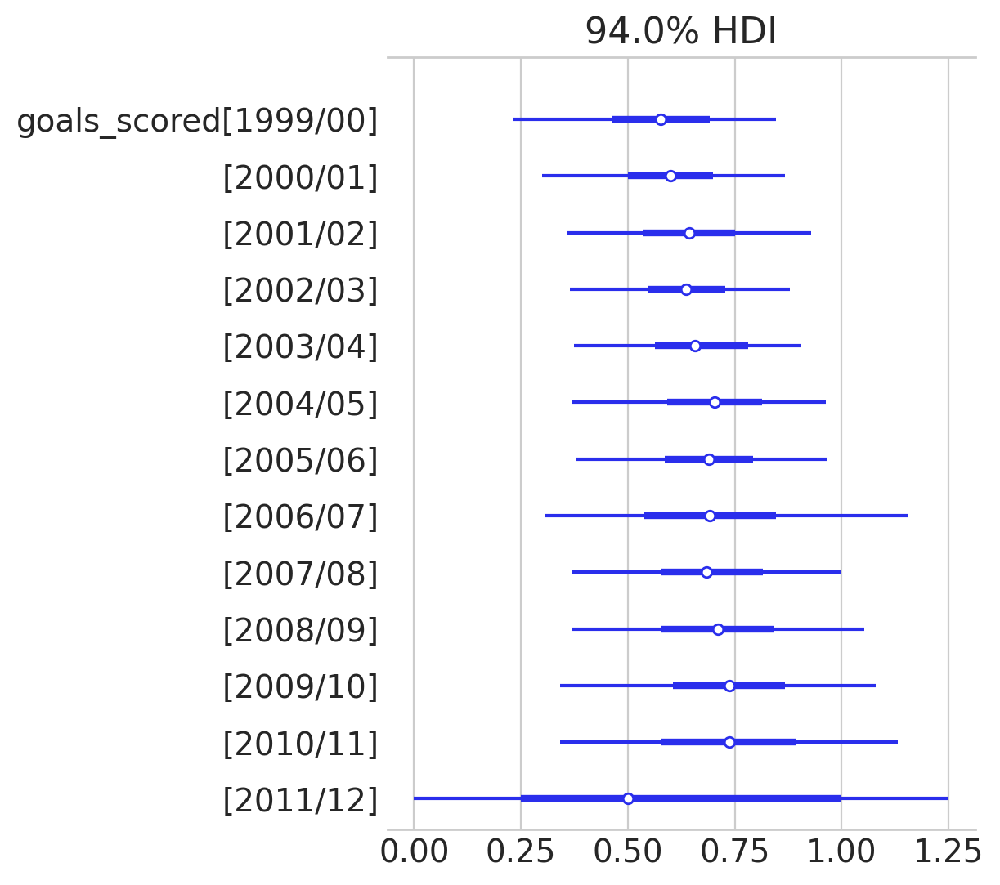

In [109]:
az.plot_forest(th_goals_preds, combined=True);

In [110]:
mindex_coords_original = xr.Coordinates.from_pandas_multiindex(
    complete_data.set_index(["name_player", "season", "days_since_first_game"]).index,
    "obs_id",
)

In [111]:
ars_probs = idata.posterior["goals_scored_probs"].rename({"goals_scored_probs_dim_0": "obs_id"}).assign_coords(mindex_coords_original).sel(name_player="thierry henry")
implied_probs_th_preds = th_preds.predictions["goals_scored_probs"].rename({"goals_scored_probs_dim_2": "obs_id"}).assign_coords(mindex_coords_counterfact)
implied_probs_th_preds = xr.merge([ars_probs, implied_probs_th_preds])

In [112]:
expected_goals = (
    (
        1 * implied_probs_th_preds.sel(event=1)
        + 2 * implied_probs_th_preds.sel(event=2)
        + 3 * implied_probs_th_preds.sel(event=3)
    )["goals_scored_probs"]
    .rename("expected_goals")
)
#player_data = complete_data.set_index("name_player")

In [114]:
th_prior_probs = idata.prior["goals_scored_probs"].rename({"goals_scored_probs_dim_0": "obs_id"}).assign_coords(mindex_coords_original).sel(name_player="thierry henry")

In [115]:
expected_goals_prior = (
    (
        1 * th_prior_probs.sel(event=1)
        + 2 * th_prior_probs.sel(event=2)
        + 3 * th_prior_probs.sel(event=3)
    )
    .rename("expected_goals")
)

### Arsenal counterfactual

In [119]:
# stay in ARS counterfactual
with SFM_rlp:
    pm.set_data(
        coords={"obs_id": ars_data.index},
        new_data={
            "seasons": ars_data["season_nbr"].to_numpy(),
            "day_id": pd.Categorical(
                ars_data["days_since_first_game"], 
                categories=match_days
            ).codes,
            "player_id": np.full_like(
                ars_data["season_nbr"], 
                fill_value=players_ordered.get_loc("thierry henry"),
            ),
            "factor_data": ars_data[factors],
            "goals_obs": np.zeros(
                len(ars_data), dtype=int
            ),  # just a placeholder for shape inference
        },
    )

In [120]:
with SFM_rlp:
    th_preds_ars = pm.sample_posterior_predictive(
        idata,
        var_names=["goals_scored_probs", "goals_scored"],
        predictions=True,
        compile_kwargs={"mode": "NUMBA"},
    )

/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.12/site-packages/pytensor/link/numba/dispatch/basic.py:377: UserWarning: Numba will use object mode to run AdvancedSubtensor's perform method
  warnings.warn(
Sampling: [goals_scored]


Output()

In [121]:
th_preds_ars.predictions = th_preds_ars.predictions.rename({"goals_scored_probs_dim_3": "event"})

mindex_coords_counterfact = xr.Coordinates.from_pandas_multiindex(
    ars_data.set_index(["season", "days_since_first_game"]).index,
    "obs_id",
)

th_preds_ars.predictions = th_preds_ars.predictions.assign_coords(mindex_coords_counterfact)
th_preds_ars.predictions_constant_data = th_preds_ars.predictions_constant_data.assign_coords(
    mindex_coords_counterfact
)
th_preds_ars.predictions

<xarray.Dataset> Size: 24MB
Dimensions:                   (chain: 4, draw: 1000, obs_id: 152,
                               goals_scored_probs_dim_2: 152, event: 4)
Coordinates:
  * chain                     (chain) int64 32B 0 1 2 3
  * draw                      (draw) int64 8kB 0 1 2 3 4 ... 995 996 997 998 999
  * goals_scored_probs_dim_2  (goals_scored_probs_dim_2) int64 1kB 0 1 ... 151
  * event                     (event) int64 32B 0 1 2 3
  * obs_id                    (obs_id) object 1kB MultiIndex
  * season                    (obs_id) object 1kB '2007/08' ... '2010/11'
  * days_since_first_game     (obs_id) int64 1kB 0 7 13 21 ... 259 266 273 280
Data variables:
    goals_scored              (chain, draw, obs_id) int64 5MB 0 1 1 1 ... 0 1 0
    goals_scored_probs        (chain, draw, goals_scored_probs_dim_2, event) float64 19MB ...
Attributes:
    created_at:                 2024-07-23T10:54:44.153483+00:00
    arviz_version:              0.18.0
    inference_library:          pymc
    inference_library_version:  5.16.2

In [122]:
th_goals_preds_ars = xr.merge([ars_est, th_preds_ars.predictions["goals_scored"].groupby("season").mean("obs_id")])

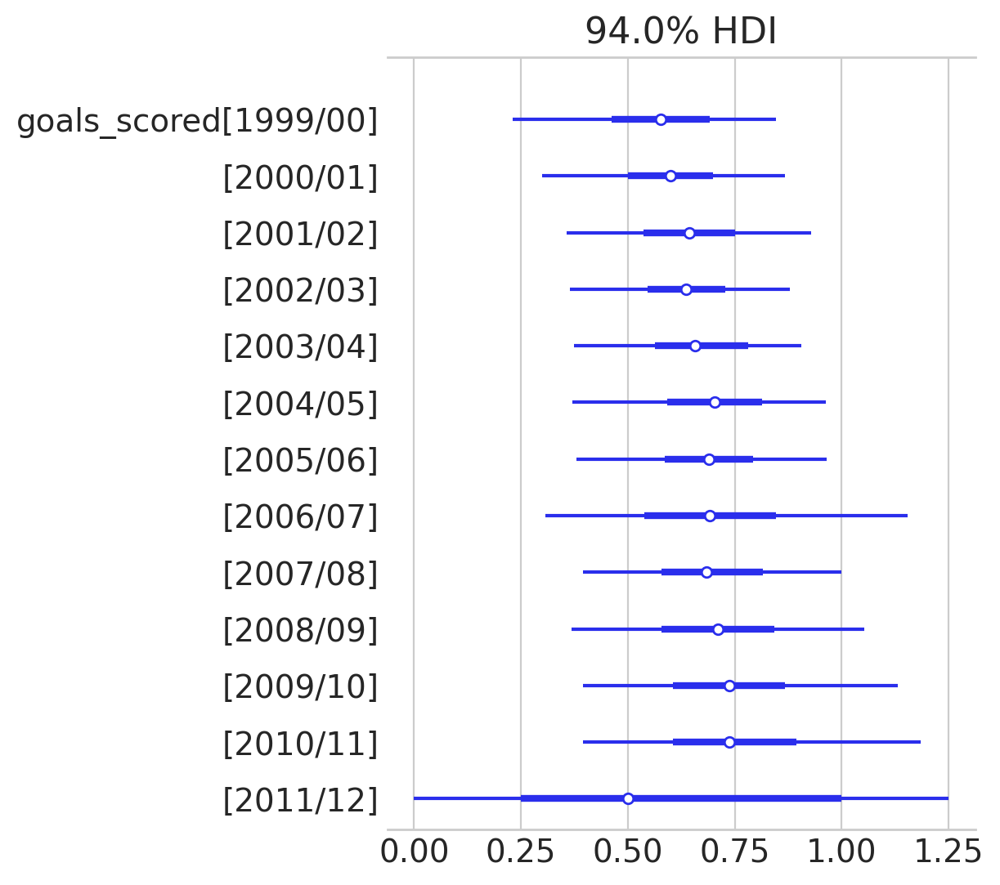

In [123]:
az.plot_forest(th_goals_preds_ars, combined=True);

In [124]:
implied_probs_th_preds_ars = xr.merge([
    ars_probs, 
    th_preds_ars.predictions["goals_scored_probs"].rename({"goals_scored_probs_dim_2": "obs_id"}).assign_coords(mindex_coords_counterfact),
])

In [125]:
expected_goals_ars = (
    (
        1 * implied_probs_th_preds_ars.sel(event=1)
        + 2 * implied_probs_th_preds_ars.sel(event=2)
        + 3 * implied_probs_th_preds_ars.sel(event=3)
    )["goals_scored_probs"]
    .rename("expected_goals")
)

### ManU counterfactual

In [134]:
# select ManU during Henry's tenure in FCB

manu_data = data_by_team.loc[
    (data_by_team["name_team"] == "manchester united")
    & (data_by_team["season"] > "2006/07")
    & (data_by_team["season"] < "2011/12")
]

manu_data["kickoff_dt"] = pd.to_datetime(
    manu_data["kickoff"], yearfirst=True
).dt.normalize()

# compute season number
manu_data["season_nbr"] = manu_data["season"].factorize(sort=True)[0] + th_data.loc[th_data["season"] == "2006/07", "season_nbr"].iloc[-1] + 1

# compute days since first game of season
manu_data["days_since_first_game"] = manu_data.groupby("season")["kickoff_dt"].transform(lambda x: (x - x.min()).dt.days)

manu_data = manu_data[
    ["season", "season_nbr", "kickoff_dt", "days_since_first_game"]
    + factors
].reset_index(drop=True)

manu_data[factors] = (manu_data[factors] - factors_mean) / factors_sd
manu_data

/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_20131/73566290.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  manu_data["kickoff_dt"] = pd.to_datetime(
/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_20131/73566290.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  manu_data["season_nbr"] = manu_data["season"].factorize(sort=True)[0] + th_data.loc[th_data["season"] == "2006/07", "season_nbr"].iloc[-1] + 1
/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_20131/73566290.

,season,season_nbr,kickoff_dt,days_since_first_game,goalsscored_rank_team,home_pitch,goalsconceded_rank_opp,goal_balance_diff
0,2007/08,8,2007-08-12,0,2.363929,0.982783,-0.919209,-0.602842
1,2007/08,8,2007-08-15,3,2.888799,-1.017290,0.545299,-0.602842
2,2007/08,8,2007-08-19,7,2.888799,-1.017290,-1.522242,-0.697955
3,2007/08,8,2007-08-26,14,3.098748,0.982783,0.286856,-0.697955
4,2007/08,8,2007-09-01,20,2.888799,0.982783,1.234479,-0.460171
...,...,...,...,...,...,...,...,...
147,2010/11,11,2011-04-23,250,-0.890269,0.982783,-0.316177,-0.935740
148,2010/11,11,2011-05-01,258,-0.890269,-1.017290,-0.919209,-2.029548
149,2010/11,11,2011-05-08,265,-0.890269,0.982783,-1.522242,-2.457559
150,2010/11,11,2011-05-14,271,-0.890269,-1.017290,0.717594,0.062955


In [135]:
# ManU counterfactual
with SFM_rlp:
    pm.set_data(
        coords={"obs_id": manu_data.index},
        new_data={
            "seasons": manu_data["season_nbr"].to_numpy(),
            "day_id": pd.Categorical(
                manu_data["days_since_first_game"], 
                categories=match_days
            ).codes,
            "player_id": np.full_like(
                manu_data["season_nbr"], 
                fill_value=players_ordered.get_loc("thierry henry"),
            ),
            "factor_data": manu_data[factors],
            "goals_obs": np.zeros(
                len(manu_data), dtype=int
            ),  # just a placeholder for shape inference
        },
    )

In [136]:
with SFM_rlp:
    th_preds_manu = pm.sample_posterior_predictive(
        idata,
        var_names=["goals_scored_probs", "goals_scored"],
        predictions=True,
        compile_kwargs={"mode": "NUMBA"},
    )

/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.12/site-packages/pytensor/link/numba/dispatch/basic.py:377: UserWarning: Numba will use object mode to run AdvancedSubtensor's perform method
  warnings.warn(
Sampling: [goals_scored]


Output()

In [139]:
th_preds_manu.predictions = th_preds_manu.predictions.rename({"goals_scored_probs_dim_3": "event"})

mindex_coords_counterfact = xr.Coordinates.from_pandas_multiindex(
    manu_data.set_index(["season", "days_since_first_game"]).index,
    "obs_id",
)

th_preds_manu.predictions = th_preds_manu.predictions.assign_coords(mindex_coords_counterfact)
th_preds_manu.predictions_constant_data = th_preds_manu.predictions_constant_data.assign_coords(
    mindex_coords_counterfact
)
th_preds_manu.predictions

<xarray.Dataset> Size: 24MB
Dimensions:                   (chain: 4, draw: 1000, obs_id: 152,
                               goals_scored_probs_dim_2: 152, event: 4)
Coordinates:
  * chain                     (chain) int64 32B 0 1 2 3
  * draw                      (draw) int64 8kB 0 1 2 3 4 ... 995 996 997 998 999
  * goals_scored_probs_dim_2  (goals_scored_probs_dim_2) int64 1kB 0 1 ... 151
  * event                     (event) int64 32B 0 1 2 3
  * obs_id                    (obs_id) object 1kB MultiIndex
  * season                    (obs_id) object 1kB '2007/08' ... '2010/11'
  * days_since_first_game     (obs_id) int64 1kB 0 3 7 14 20 ... 258 265 271 279
Data variables:
    goals_scored              (chain, draw, obs_id) int64 5MB 1 0 0 2 ... 0 0 1
    goals_scored_probs        (chain, draw, goals_scored_probs_dim_2, event) float64 19MB ...
Attributes:
    created_at:                 2024-07-23T11:09:29.629976+00:00
    arviz_version:              0.18.0
    inference_library:          pymc
    inference_library_version:  5.16.2

In [140]:
th_goals_preds_manu = xr.merge([ars_est, th_preds_manu.predictions["goals_scored"].groupby("season").mean("obs_id")])

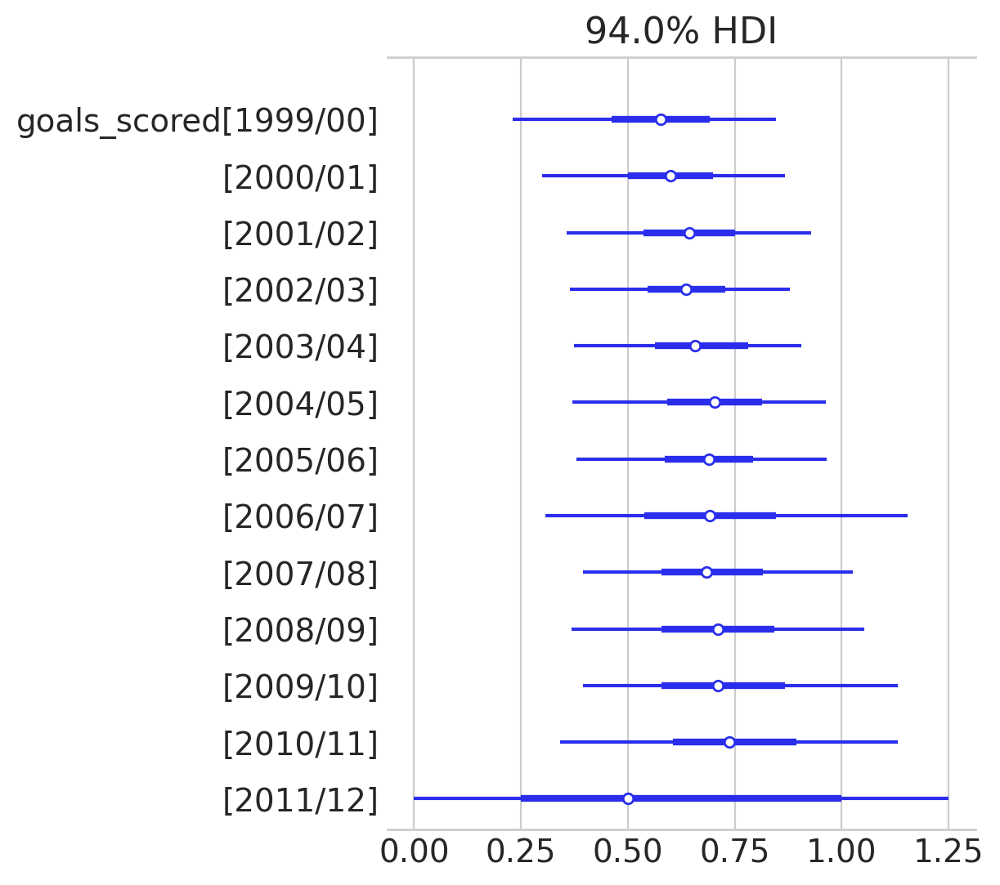

In [141]:
az.plot_forest(th_goals_preds_manu, combined=True);

In [142]:
implied_probs_th_preds_manu = xr.merge([
    ars_probs, 
    th_preds_manu.predictions["goals_scored_probs"].rename({"goals_scored_probs_dim_2": "obs_id"}).assign_coords(mindex_coords_counterfact),
])

In [143]:
expected_goals_manu = (
    (
        1 * implied_probs_th_preds_manu.sel(event=1)
        + 2 * implied_probs_th_preds_manu.sel(event=2)
        + 3 * implied_probs_th_preds_manu.sel(event=3)
    )["goals_scored_probs"]
    .rename("expected_goals")
)

### Comparison plots

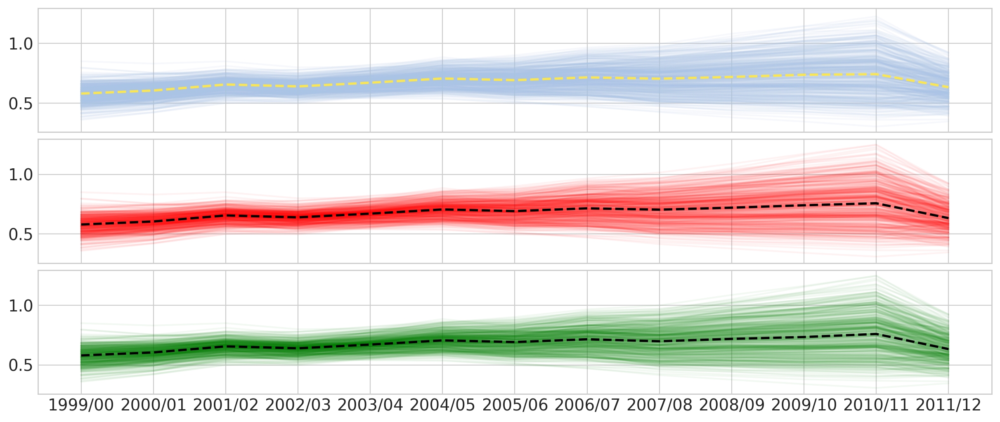

In [144]:
th_seasons = np.unique(expected_goals["season"].to_numpy())
avg_exp_goals = az.extract(expected_goals.groupby("season").mean("obs_id"))["expected_goals"]
avg_exp_goals_ars = az.extract(expected_goals_ars.groupby("season").mean("obs_id"))["expected_goals"]
avg_exp_goals_manu = az.extract(expected_goals_manu.groupby("season").mean("obs_id"))["expected_goals"]
avg_exp_goals_prior = az.extract(expected_goals_prior.groupby("season").mean("obs_id"))["expected_goals"]

_, axes = plt.subplots(3, 1, figsize=(12, 5), sharex=True, sharey=True, layout="constrained")

# player_preds = az.extract(th_preds.predictions)["goals_scored"].sel(
#     sample=(
#         rng.choice(th_preds.predictions.chain),
#         rng.choice(th_preds.predictions.draw),
#     ),
# )

# ax.plot(
#     player_preds["season_nbr"],
#     player_preds + rng.normal(0, jitter_strength, player_preds.shape),
#     marker="o",
#     linestyle="None",
#     color="#AAC4E6",
#     alpha=0.8,
# )
axes[0].plot(
    th_seasons,
    avg_exp_goals.sel(sample=slice(None, None, 10)),
    color="#AAC4E6",
    alpha=0.1,
)
axes[1].plot(
    th_seasons,
    avg_exp_goals_ars.sel(sample=slice(None, None, 10)),
    color="red",
    alpha=0.05,
)
axes[2].plot(
    th_seasons,
    avg_exp_goals_manu.sel(sample=slice(None, None, 10)),
    color="green",
    alpha=0.05,
)
# axes.plot(
#     np.unique(expected_goals_prior["season"].to_numpy()),
#     avg_exp_goals_prior.sel(sample=slice(None, None, 10)),
#     color="k",
#     alpha=0.1,
# )
axes[0].plot(
    th_seasons, 
    avg_exp_goals.mean("sample"), 
    color="#FBE64D", lw=2, ls="--",
)
axes[1].plot(
    th_seasons, 
    avg_exp_goals_ars.mean("sample"), 
    color="k",
    lw=2, ls="--",
)
axes[2].plot(
    th_seasons, 
    avg_exp_goals_manu.mean("sample"), 
    color="k",
    lw=2, ls="--",
);
# axes.plot(
#     np.unique(expected_goals_prior["season"].to_numpy()),
#     avg_exp_goals_prior.mean("sample"), 
#     lw=2, ls="--", color="k",
# );
# ax.scatter(
#     player_data.loc[player, "season_nbr"],
#     player_data.loc[player, "goals_cats"]
#     + rng.normal(0, jitter_strength, len(player_data.loc[player, "goals_cats"])),
#     c="grey",
#     alpha=0.8,
# )

# ax.set(
#     title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
#     xlabel="Season nbr",
#     ylabel="Goal",
# )
# if i == 2:
#     handles = [
#         Line2D(
#             [], [], color="grey", marker="o", linestyle="None", label="Observed"
#         ),
#         Line2D(
#             [],
#             [],
#             color="#AAC4E6",
#             marker="o",
#             linestyle="None",
#             label="Predicted career",
#         ),
#         Line2D([], [], color="#FBE64D", ls="--", label="Average"),
#         Line2D(
#             [],
#             [],
#             color="#70133A",
#             alpha=0.8,
#             marker="s",
#             markersize=10,
#             linestyle="None",
#             label="75% Envelope",
#         ),
#     ]
#     ax.legend(handles=handles, fontsize=10, frameon=True, ncols=2)

# plt.suptitle("Expected Goals per Game\nMid-season Projection", fontsize=18);

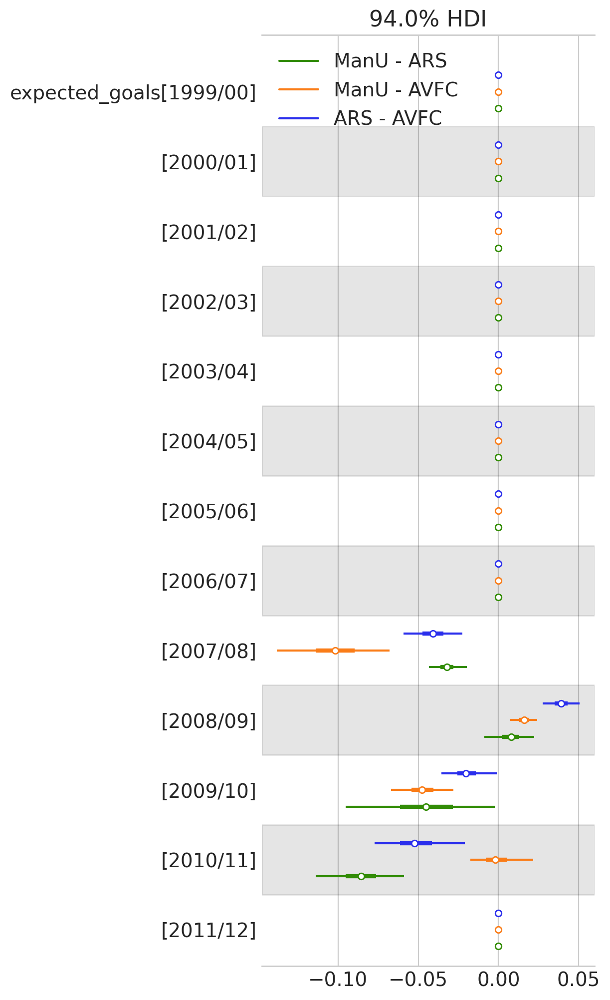

In [147]:
az.plot_forest(
    data=[
        (expected_goals_ars - expected_goals).groupby("season").mean("obs_id"),
        (expected_goals_manu - expected_goals).groupby("season").mean("obs_id"),
        (expected_goals_manu - expected_goals_ars).groupby("season").mean("obs_id"),
    ],
    model_names=["ARS - AVFC", "ManU - AVFC", "ManU - ARS"],
    combined=True);

## PAR Analysis

With teams factors = 0 ?

In [106]:
post_preds = idata.posterior_predictive.reset_index("obs_id")
rlp_perf = post_preds["goals_scored"].where(
    post_preds["name_player"].isin(coords["rlp"]), drop=True
)
elite_perf = post_preds["goals_scored"].where(
    post_preds["name_player"].isin(coords["elite"]), drop=True
)
par = (
    elite_perf.groupby("name_player").mean("obs_id") - rlp_perf.mean("obs_id")
).rename("PAR")

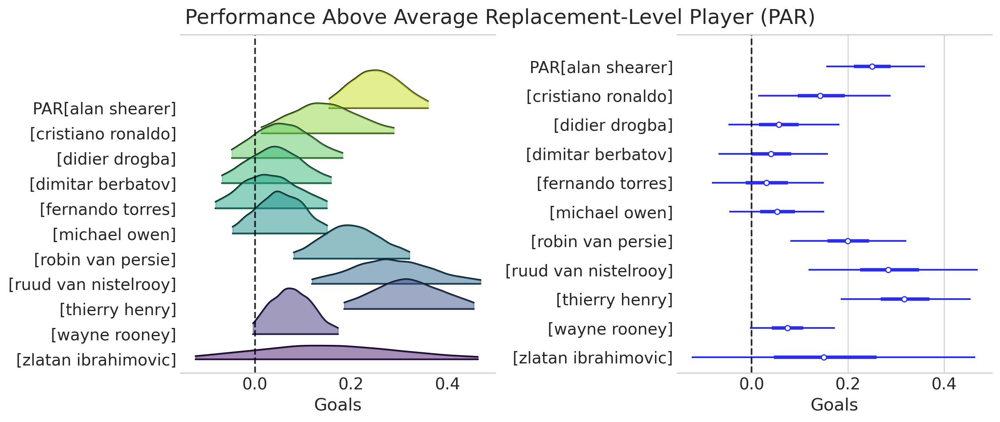

In [107]:
_, (left, right) = plt.subplots(1, 2, sharex=True)
az.plot_forest(
    par,
    combined=True,
    kind="ridgeplot",
    ridgeplot_overlap=1.5,
    ridgeplot_alpha=0.5,
    ax=left,
)
colors = sns.color_palette("viridis", n_colors=len(coords["elite"]))
# adjust colors manually
for patch, color in zip(left.collections, colors):
    patch.set_color(color)
left.axvline(c="k", ls="--", alpha=0.8)
left.set(title="", xlabel="Goals")

az.plot_forest(par, combined=True, ax=right)
right.axvline(c="k", ls="--", alpha=0.8)
right.set(title="", xlabel="Goals")
plt.suptitle("Performance Above Average Replacement-Level Player (PAR)", fontsize=18);

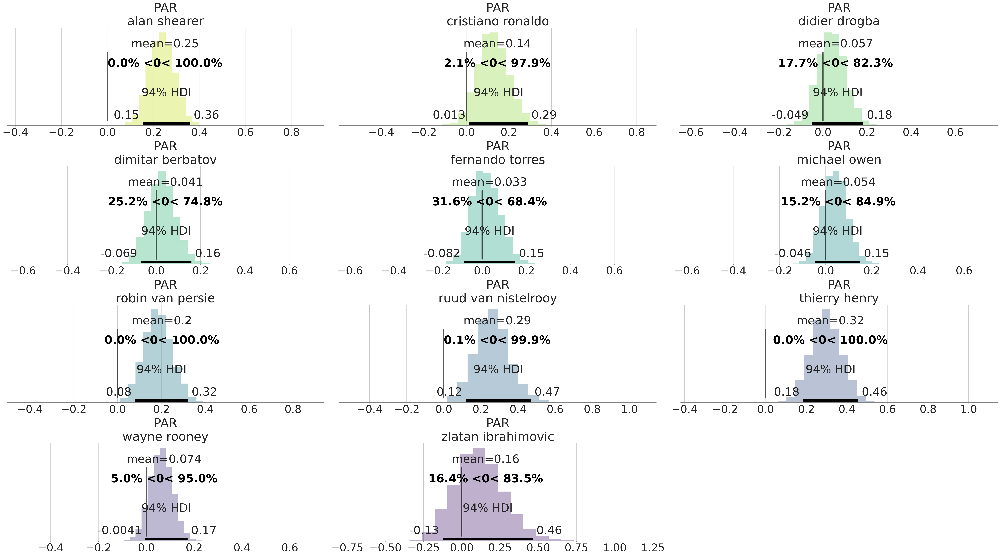

In [108]:
axes = az.plot_posterior(
    par,
    kind="hist",
    round_to=2,
    grid=(4, 3),
    textsize=32,
    ref_val=0,
    ref_val_color="k",
)

# customize bar colors
for ax, color in zip(axes.flatten(), colors[::-1]):
    for bar in ax.patches:
        bar.set_facecolor(color)

## TO DO: 3D plot

## Packages versions

In [109]:
%load_ext watermark
%watermark -n -u -v -iv -w

Last updated: Thu Jun 27 2024

Python implementation: CPython
Python version       : 3.11.9
IPython version      : 8.22.2

numpy     : 1.26.4
pandas    : 2.2.2
seaborn   : 0.13.2
matplotlib: 3.8.4
pymc      : 5.15.1+31.gf44071bd
xarray    : 2024.3.0
arviz     : 0.18.0
pytensor  : 2.22.1

Watermark: 2.4.3

